In [1]:
import os
import numpy as np
import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits import mplot3d
%matplotlib notebook 
import seaborn as sns
import pandas as pd
sns.set_style("whitegrid")
sns.set_context("poster")
from sklearn import linear_model,svm,ensemble,tree

# special matplotlib argument for improved plots
from matplotlib import rcParams

import samples
reload(samples)
import spectral
reload(spectral)
import audiolearning
reload(audiolearning)
import mytimer as mt
reload(mt)
print

In [2]:
FFT_BINS = 60;
FWIN = 25;
TWIN = 1;
NPERSEG = 1024;
TSUB = 1; #NOTE: this will be used only for training. Will experiment with test format later.
NSUB = 10;
#Last day of 'training' data
MONTH = 5;
DAY = 26;

In [3]:
train_samples,test_samples = samples.getGeneralizationTestSet(MONTH,DAY,Tsub=TSUB,Nsub=NSUB,READ_IN=True)

Imported 1507 Supersamples


In [4]:
class phi_sped_mfcc:
    LEN = 0;
    def __init__(self,fft_bins):
        #self.LEN = fft_bins;
        self.LEN = fft_bins+13;
        self.fft_bins = fft_bins;

    def get_phi(self,sample):
        '''
        Takes in a super_sample and returns a feature array. Breaks the super_sample
        down into samples. Each row of the returned value corresponds to a sample
        in the super sample.
        '''

        XSPED = spectral.getSupersampleSPED(sample,self.fft_bins,fwin=FWIN,twin = TWIN,nperseg = NPERSEG,spacing="log")
        XMFCC = spectral.getSampleMFCC(sample)
        return np.hstack((XMFCC,XSPED))

In [5]:
data_file = 'generalization%02i%02i_%i_%i_%i_%i_%i_%i.pkl'%(MONTH,DAY,TSUB,NSUB,FFT_BINS,FWIN,TWIN,NPERSEG)
myPhi = phi_sped_mfcc(FFT_BINS)
extractor = audiolearning.Classifier(myPhi)

In [6]:
if os.path.exists(data_file):
    with open(data_file,"rb") as myPkl:
        (trainData,generalData) = pickle.load(myPkl);
        X_train = trainData.X_flat;
        Y_train = trainData.Y_flat;
        X_train_compact = trainData.X
        Y_train_compact = trainData.Y
        
        X_test = generalData.X_flat;
        Y_test = generalData.Y_flat;
        X_test_compact = generalData.X
        Y_test_compact = generalData.Y
    m, nsub, nfeat = np.shape(X_train_compact)
else:
    train_samples,test_samples = samples.getGeneralizationTestSet(MONTH,DAY,Tsub=TSUB,Nsub=NSUB,READ_IN=True)
    
    
    (X_test_compact,Y_test_compact) = extractor.extract_features(train_samples)
    m, nsub, nfeat = np.shape(X_test_compact)
    X_test = np.reshape(X_test_compact,(m*nsub,nfeat))
    Y_test = np.repeat(Y_test_compact,nsub)    
    generalData = samples.DataPhi()
    generalData.X = X_test_compact
    generalData.Y = Y_test_compact
    generalData.X_flat = X_test
    generalData.Y_flat = Y_test
    
    (X_train_compact,Y_train_compact) = extractor.extract_features(train_samples)
    m, nsub, nfeat = np.shape(X_train_compact)
    X_train = np.reshape(X_train_compact,(m*nsub,nfeat))
    Y_train = np.repeat(Y_train_compact,nsub)    
    trainData = samples.DataPhi()
    trainData.X = X_train_compact
    trainData.Y = Y_train_compact
    trainData.X_flat = X_train
    trainData.Y_flat = Y_train
    with open(data_file,'wb') as f:
        pickle.dump((trainData,generalData),f)

In [7]:
train_samples[0].__dict__

{'L': 441000,
 'Lsub': 44100,
 'Nsub': 10,
 'data': array([ 0.        ,  0.        ,  0.        , ..., -0.00338745,
        -0.0039978 , -0.00228882]),
 'data_loaded': 1,
 'date': datetime.date(2016, 5, 15),
 'filename': 'recording-20160515-185508.wav',
 'path': 'G:\\Google_Drive\\AudioLocator\\Recordings\\Arrillaga\\recording-20160515-185508.wav',
 'region': 6,
 'start_index': 0,
 'time': datetime.time(18, 55, 8),
 'waveparms': <samples.AudioParms instance at 0x000000000ACF7588>,
 'weekday': 6}

In [38]:
mfcc1 = spectral.getSignalMFCC(train_samples[1].data)

In [57]:
train_samples[1].__dict__

{'L': 441000,
 'Lsub': 44100,
 'Nsub': 10,
 'data': array([-0.00265503, -0.00302124, -0.00186157, ..., -0.00045776,
        -0.00057983, -0.00082397]),
 'data_loaded': 1,
 'date': datetime.date(2016, 5, 15),
 'filename': 'recording-20160515-185508.wav',
 'path': 'G:\\Google_Drive\\AudioLocator\\Recordings\\Arrillaga\\recording-20160515-185508.wav',
 'region': 6,
 'start_index': 441000,
 'time': datetime.time(18, 55, 8),
 'waveparms': <samples.AudioParms instance at 0x000000000B183BC8>,
 'weekday': 6}

In [62]:
train_samples[25].__dict__

{'L': 441000,
 'Lsub': 44100,
 'Nsub': 10,
 'data': array([ 0.00686646,  0.00582886,  0.006073  , ...,  0.        ,
         0.00045776,  0.0012207 ]),
 'data_loaded': 1,
 'date': datetime.date(2016, 5, 15),
 'filename': 'recording-20160515-190142.wav',
 'path': 'G:\\Google_Drive\\AudioLocator\\Recordings\\Arrillaga\\recording-20160515-190142.wav',
 'region': 6,
 'start_index': 441000,
 'time': datetime.time(19, 1, 42),
 'waveparms': <samples.AudioParms instance at 0x000000000B5245C8>,
 'weekday': 6}

<Container object of 3 artists>

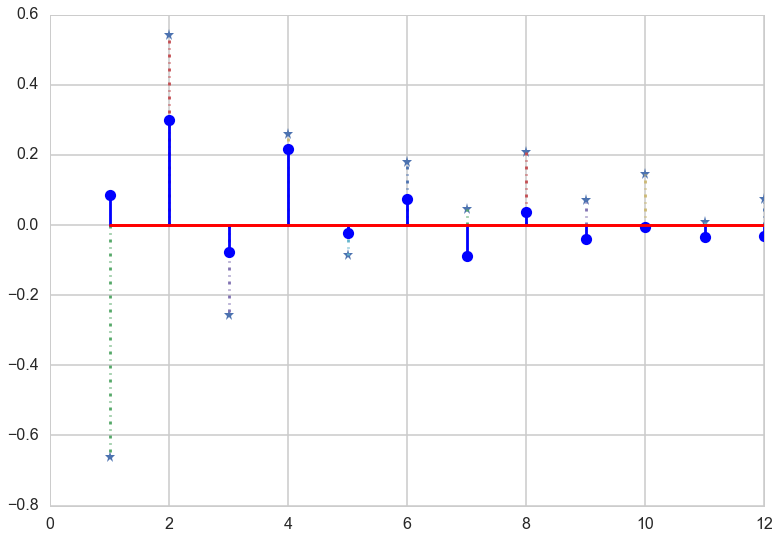

In [82]:
mfcc25 = spectral.getSignalMFCC(train_samples[25].data)
mfcc1 = spectral.getSignalMFCC(train_samples[1].data)
plt.stem(range(1,13),mfcc25[1:],'-.',markerfmt ='*',markerfacecolor='r')
plt.stem(range(1,13),mfcc1[1:],)

In [69]:
train_samples[700].__dict__

{'L': 441000,
 'Lsub': 44100,
 'Nsub': 10,
 'data': array([-0.02105713,  0.01757812,  0.06051636, ...,  0.02429199,
         0.03094482,  0.02947998]),
 'data_loaded': 1,
 'date': datetime.date(2016, 5, 16),
 'filename': 'recording-20160516-140121.wav',
 'path': 'G:\\Google_Drive\\AudioLocator\\Recordings\\Tresidder\\recording-20160516-140121.wav',
 'region': 2,
 'start_index': 1764000,
 'time': datetime.time(14, 1, 21),
 'waveparms': <samples.AudioParms instance at 0x000000000B7C28C8>,
 'weekday': 0}

In [77]:
train_samples[600].__dict__

{'L': 441000,
 'Lsub': 44100,
 'Nsub': 10,
 'data': array([ 0.        ,  0.        ,  0.        , ...,  0.00292969,
         0.00170898, -0.00073242]),
 'data_loaded': 1,
 'date': datetime.date(2016, 5, 16),
 'filename': 'recording-20160516-153226.wav',
 'path': 'G:\\Google_Drive\\AudioLocator\\Recordings\\Rains\\recording-20160516-153226.wav',
 'region': 0,
 'start_index': 0,
 'time': datetime.time(15, 32, 26),
 'waveparms': <samples.AudioParms instance at 0x000000000B79E288>,
 'weekday': 0}

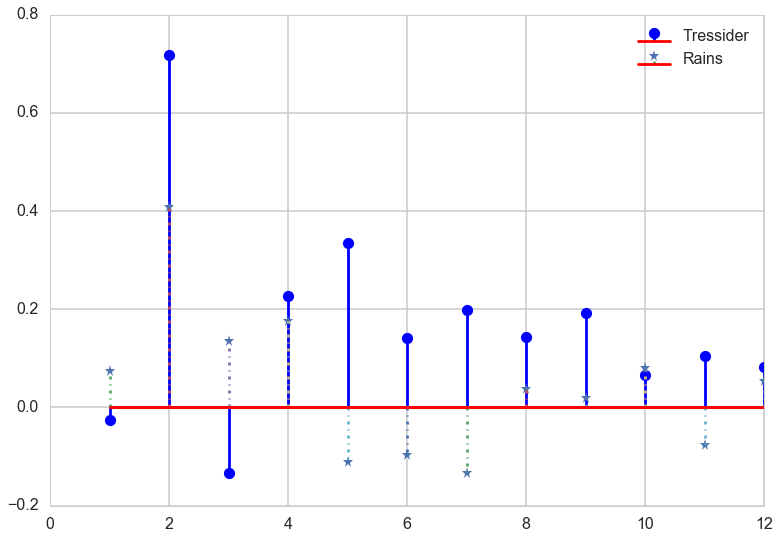

In [81]:
mfcc700 = spectral.getSignalMFCC(train_samples[700].data)
mfcc600 = spectral.getSignalMFCC(train_samples[600].data)
plt.stem(range(1,13),mfcc600[1:],'-.')
plt.stem(range(1,13),mfcc700[1:],markerfmt ='*',markerfacecolor='r')
plt.legend(['Tressider','Rains'])

In [8]:
from sklearn.decomposition import PCA
from sklearn import preprocessing

<IPython.core.display.Javascript object>


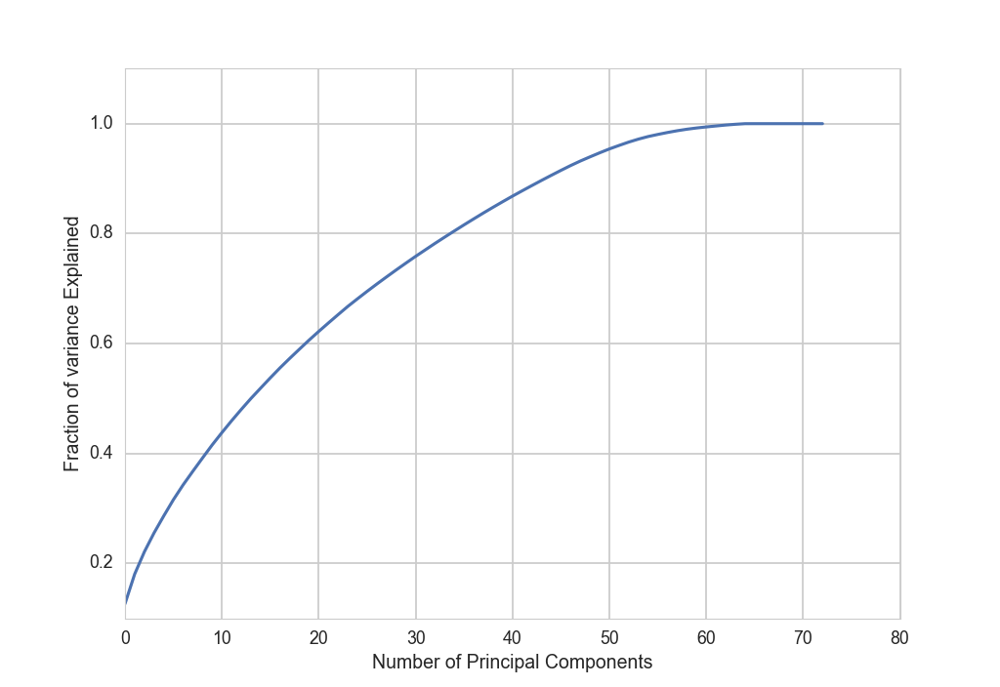

Number of Principal Components to explain 95.00% of variance: 50


PCA(copy=True, n_components=50, whiten=False)

In [9]:
pca = PCA(n_components=None,whiten=False)

X_pca = pca.fit_transform(preprocessing.scale(X_train),Y_train)
var_thresh = 0.95
var_exp = pca.explained_variance_ratio_.cumsum()
plt.plot(var_exp)
num_pcs = np.where(var_exp>=var_thresh)[0][0]
plt.xlabel('Number of Principal Components')
plt.ylabel('Fraction of variance Explained')
print "Number of Principal Components to explain %.2f%% of variance: %d" %(var_thresh*100,num_pcs)
pca.set_params(n_components=num_pcs)

In [10]:
def plotRegions(regions,dataframe,i=None,j=None,ax=None):
    num = len(regions)
    colors = sns.color_palette("hls", 8)
    markers = ['^','o','x','v','<','>','*']
    if ax is None:
        fig =plt.figure()
        ax = Axes3D(fig,elev=-140, azim=80)
    if i==None:
        for region_name,color,marker in zip(regions,colors,markers):
            region = samples.Regions_dict[region_name]
            mask = dataframe['REGION']==region
            ax.scatter(dataframe[mask]['pc1'],dataframe[mask]['pc2'],dataframe[mask]['pc3'],c=color,label=region_name,marker=marker)
    else:
        region_name = samples.REGIONS[i]
        mask = dataframe['REGION']==i
        ax.scatter(dataframe[mask]['pc1'],dataframe[mask]['pc2'],dataframe[mask]['pc3'],c=colors[i],label=region_name,marker=markers[i])
        region_name = samples.REGIONS[j]
        mask = dataframe['REGION']==j
        ax.scatter(dataframe[mask]['pc1'],dataframe[mask]['pc2'],dataframe[mask]['pc3'],c=colors[j],label=region_name,marker=markers[j])


    plt.legend()
    return ax

# Plots suggest that PCA is making the data too scrunched together

<IPython.core.display.Javascript object>


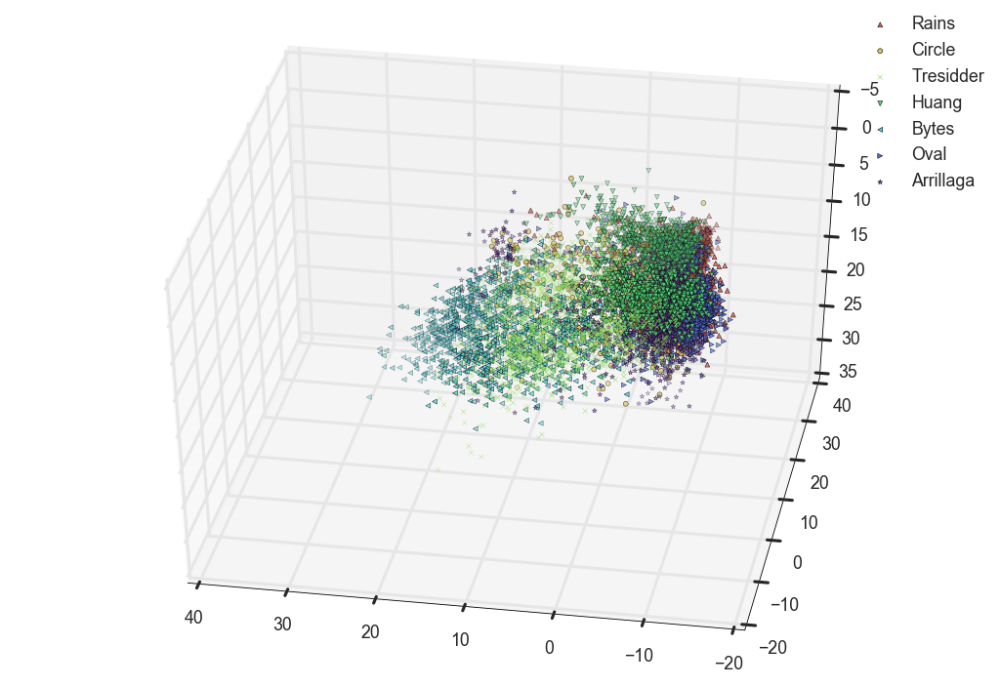

<IPython.core.display.Javascript object>


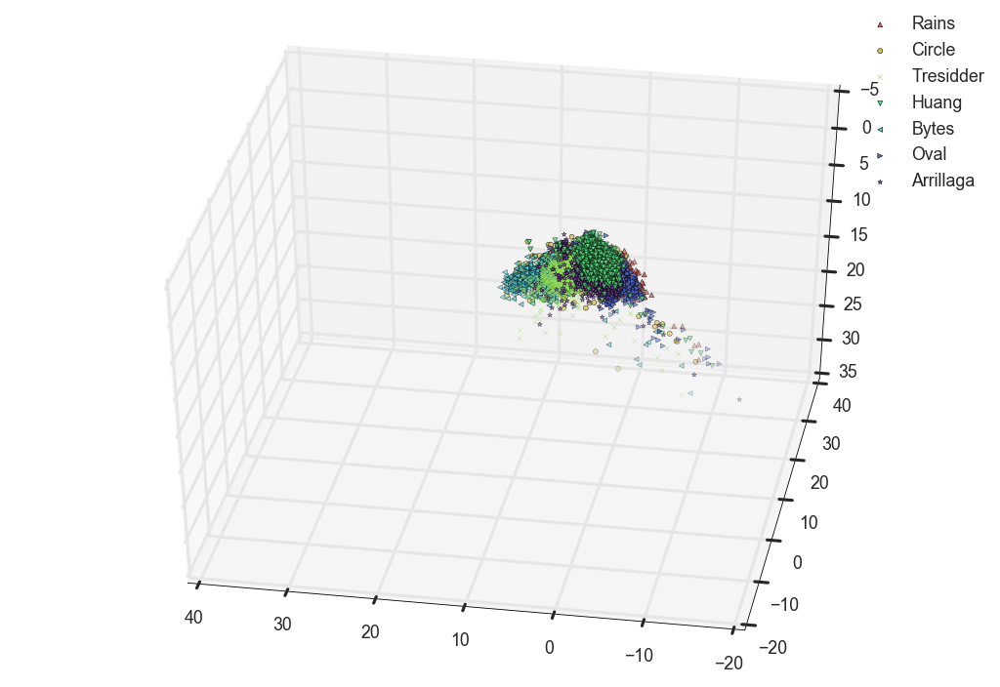

<function matplotlib.pyplot.show>

In [11]:
pca_df_test = pd.DataFrame()
test_pca = pca.transform(X_test)
for i in range(num_pcs):
    pca_df_test["pc%i" % (i+1)] = test_pca[:,i]
pca_df_test['REGION'] = Y_test
ax = plotRegions(samples.REGIONS,pca_df_test,ax=None)
xlims = ax.get_xlim()
ylims = ax.get_ylim()
zlims = ax.get_zlim()

pca_df_train = pd.DataFrame()
for i in range(num_pcs):
    pca_df_train["pc%i" % (i+1)] = X_pca[:,i]    
pca_df_train['REGION'] = Y_train
ax = plotRegions(samples.REGIONS,pca_df_train,ax=None)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_zlim(zlims)
plt.show

<IPython.core.display.Javascript object>


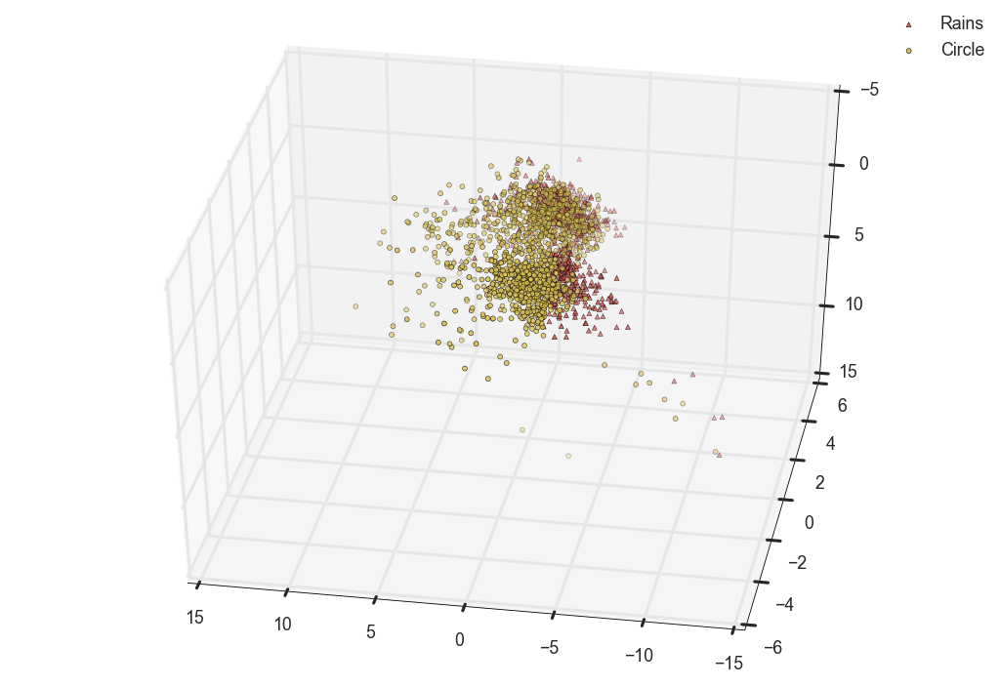

<IPython.core.display.Javascript object>


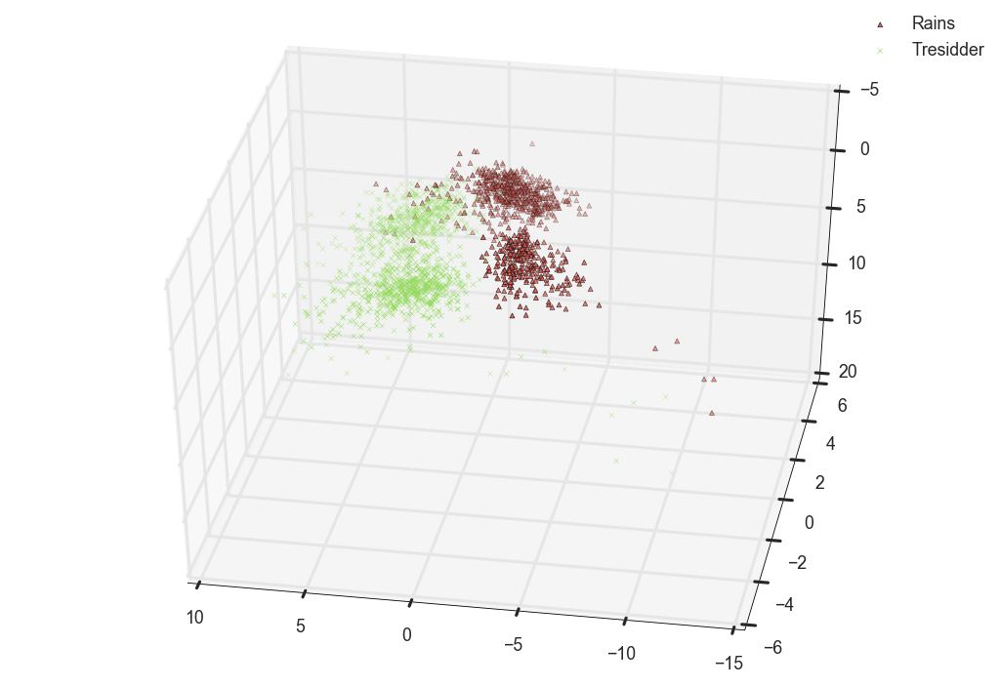

<IPython.core.display.Javascript object>


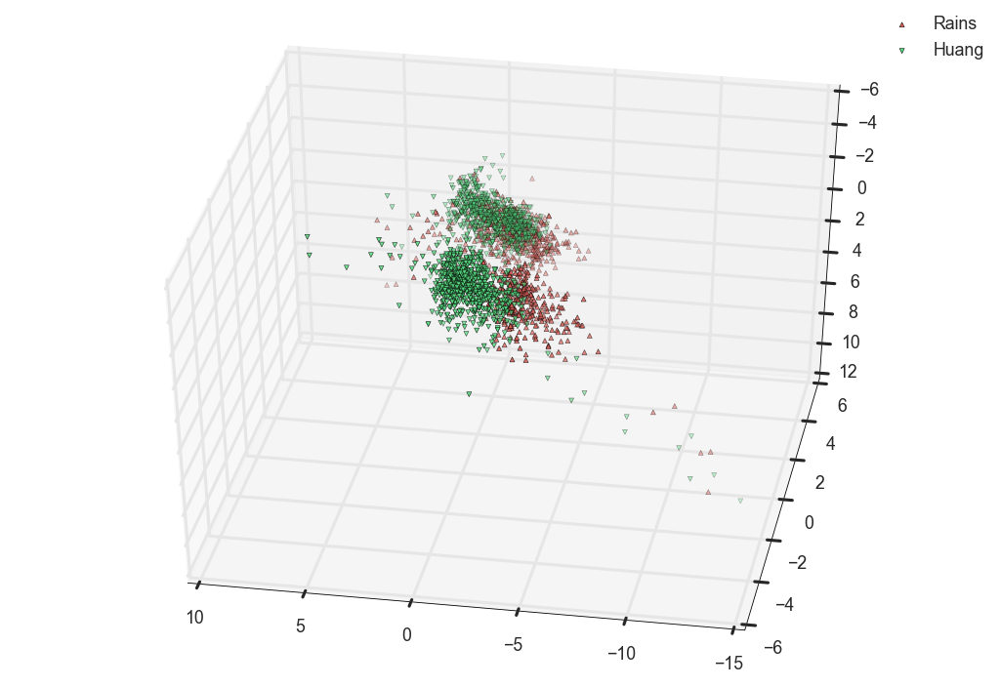

<IPython.core.display.Javascript object>


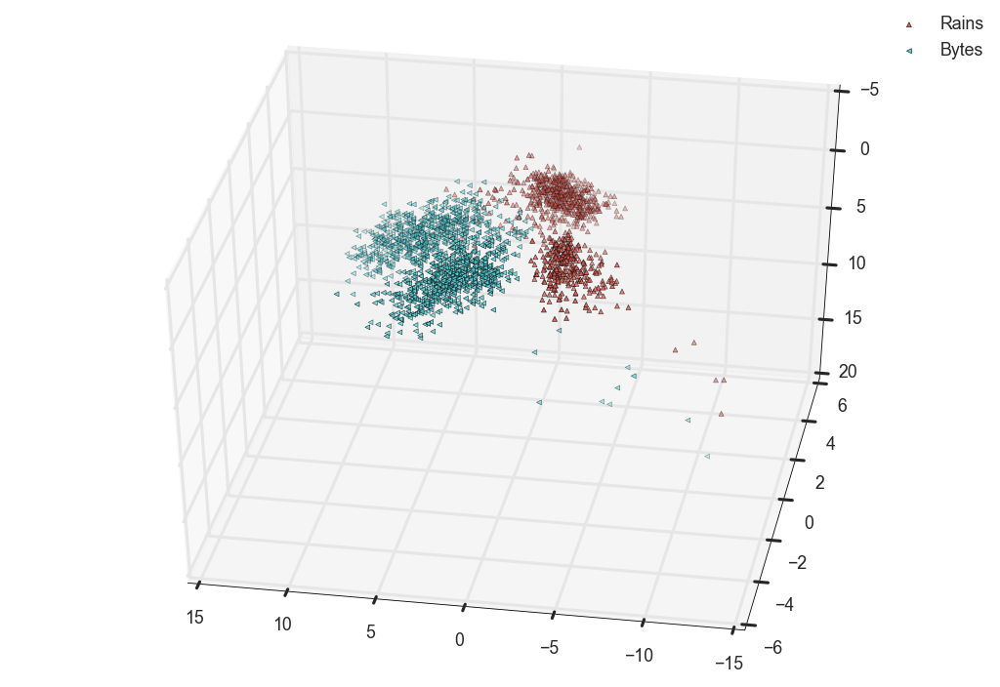

<IPython.core.display.Javascript object>


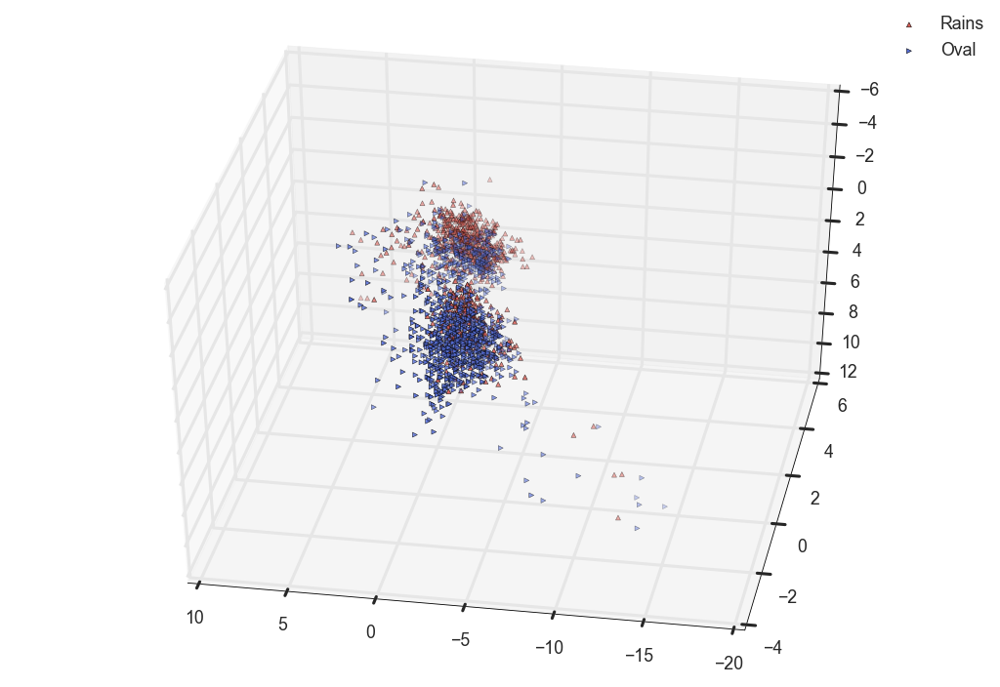

<IPython.core.display.Javascript object>


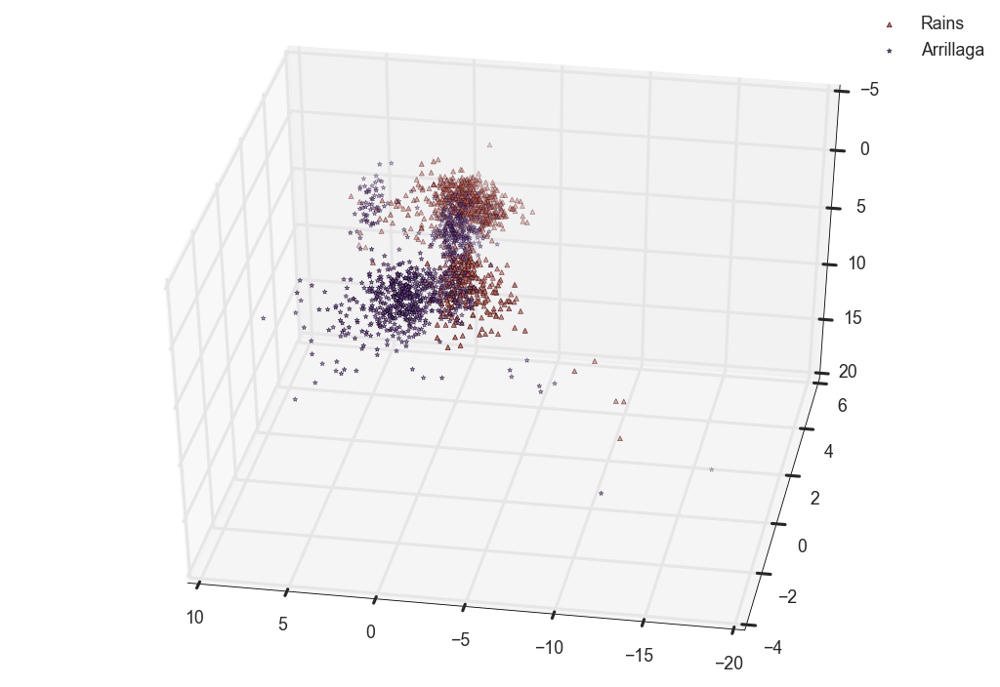

<IPython.core.display.Javascript object>


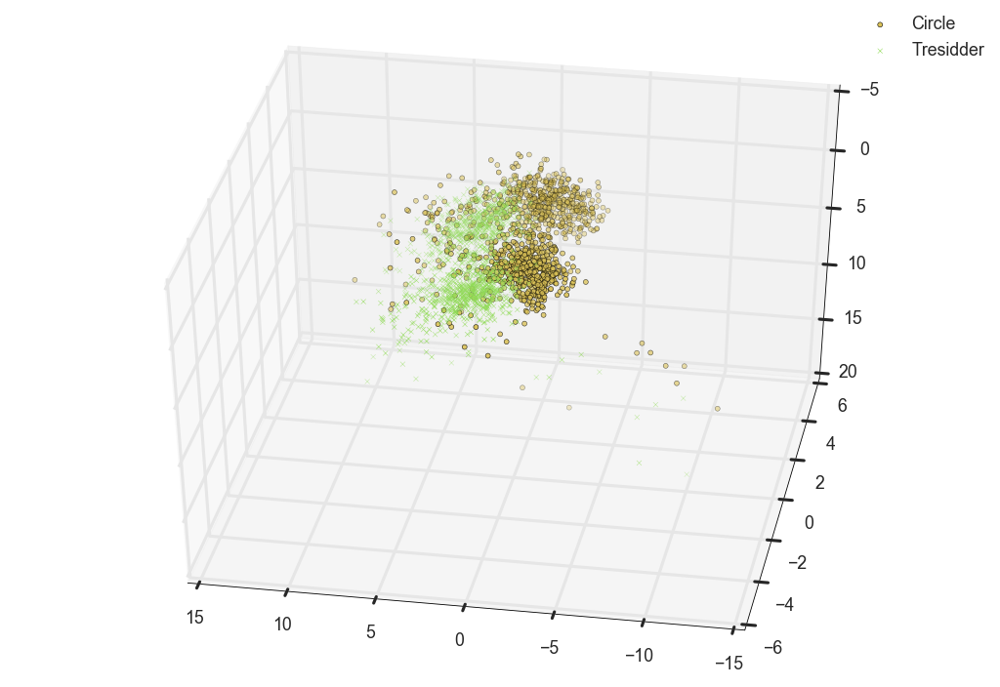

<IPython.core.display.Javascript object>


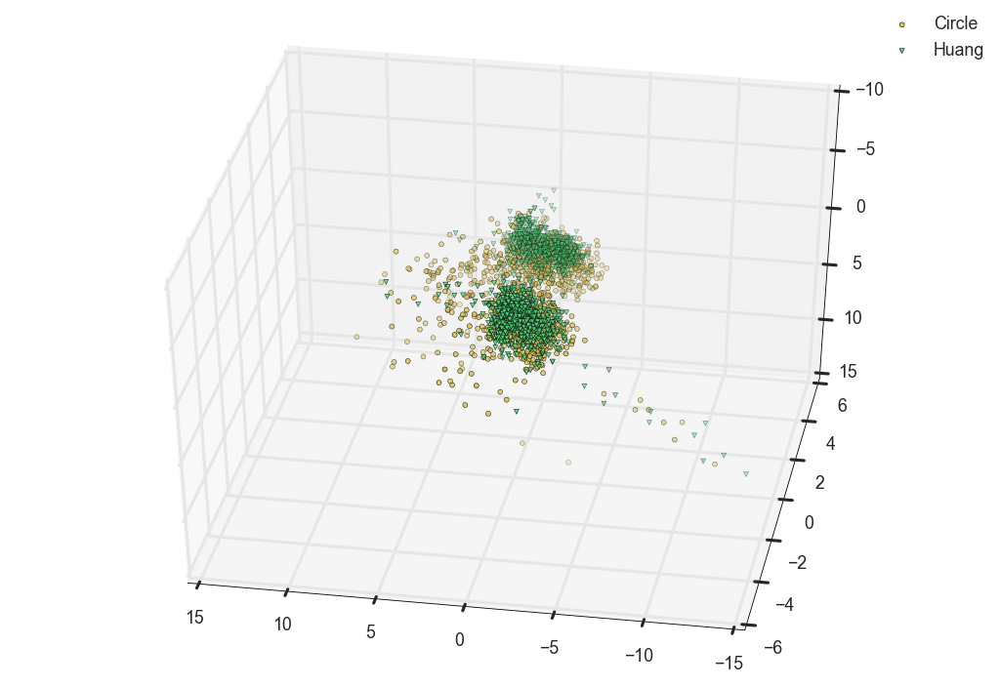

<IPython.core.display.Javascript object>


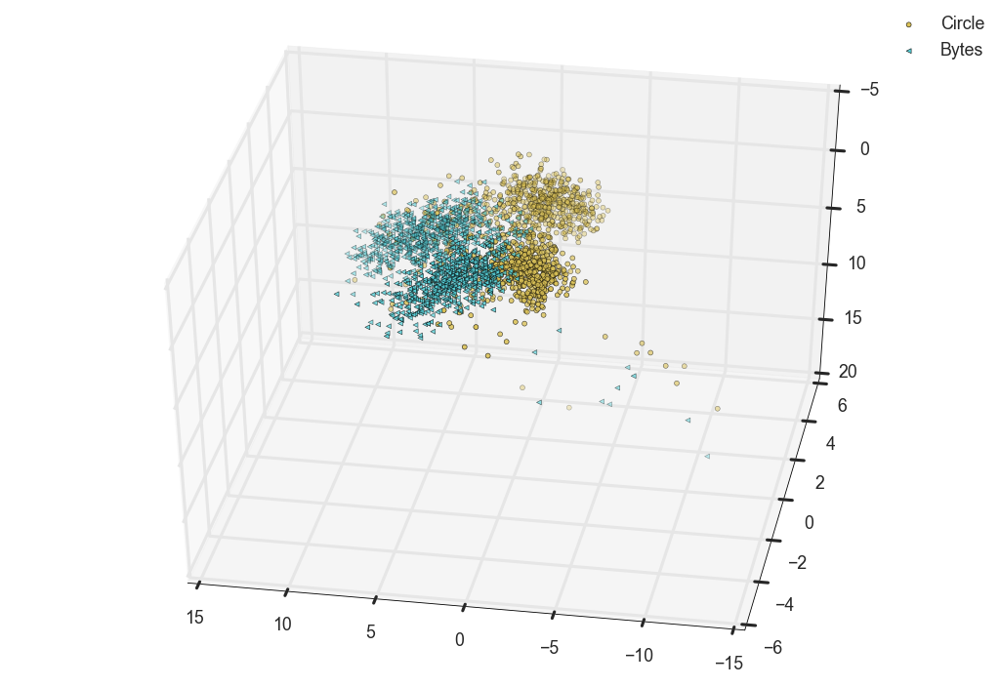

<IPython.core.display.Javascript object>


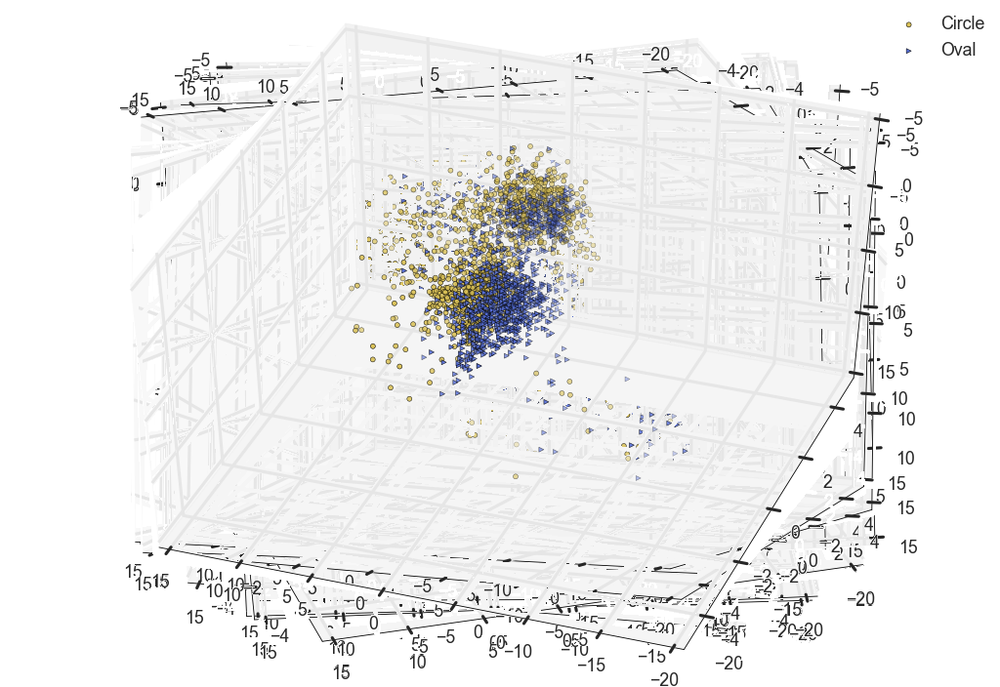

<IPython.core.display.Javascript object>


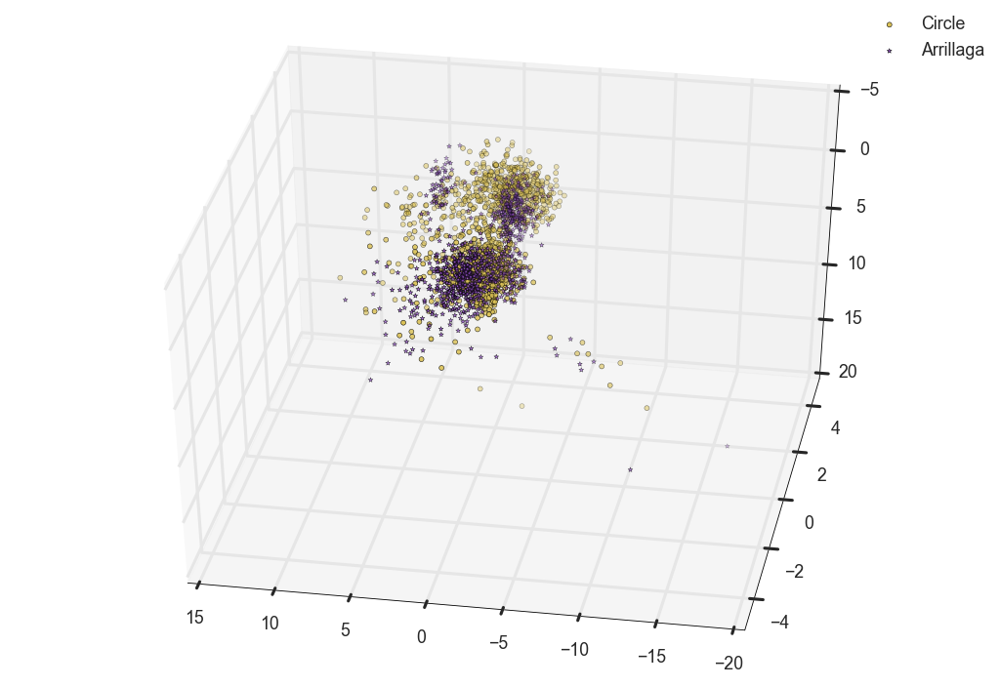

<IPython.core.display.Javascript object>


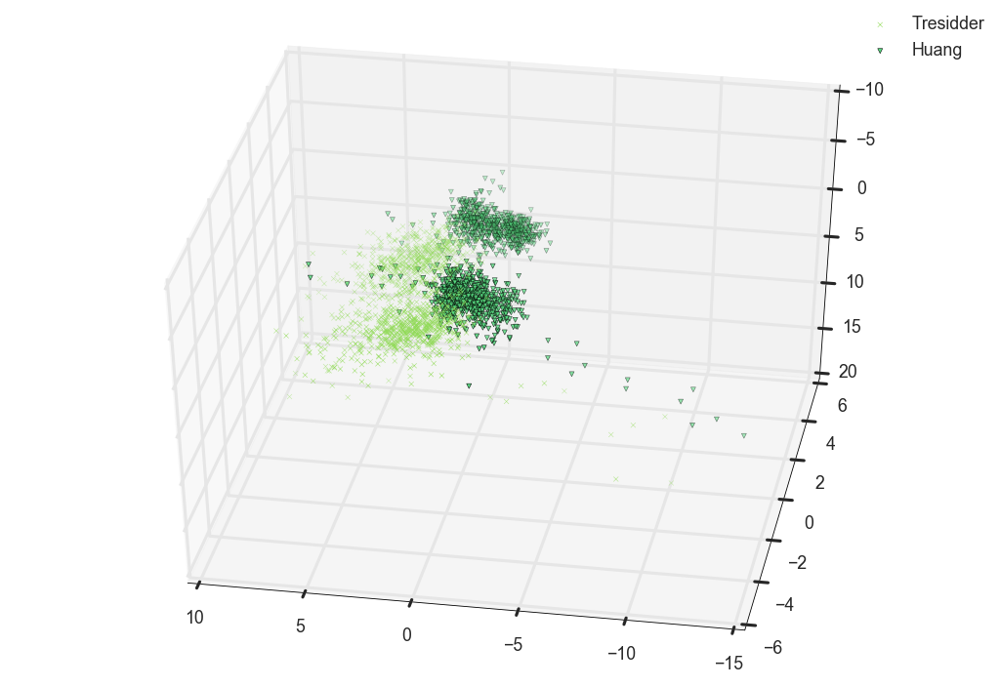

<IPython.core.display.Javascript object>


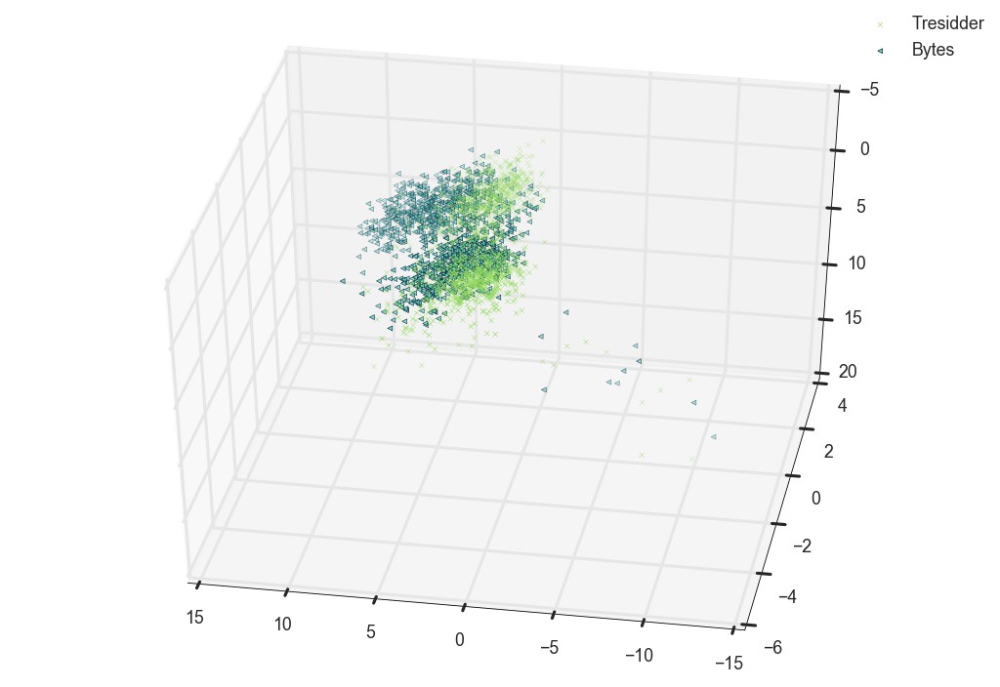

<IPython.core.display.Javascript object>


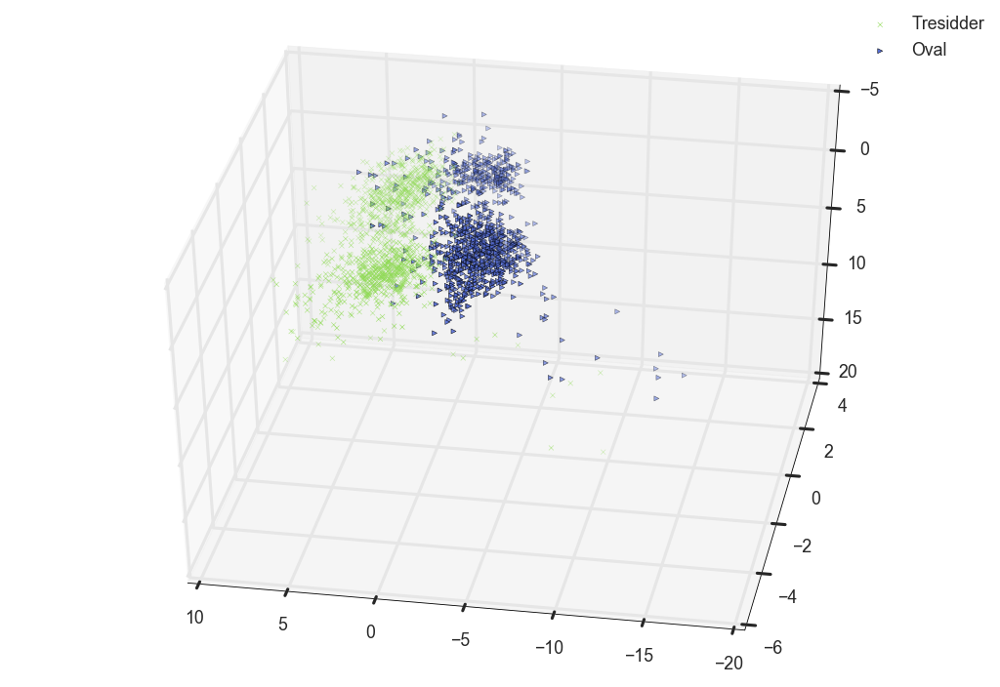

<IPython.core.display.Javascript object>


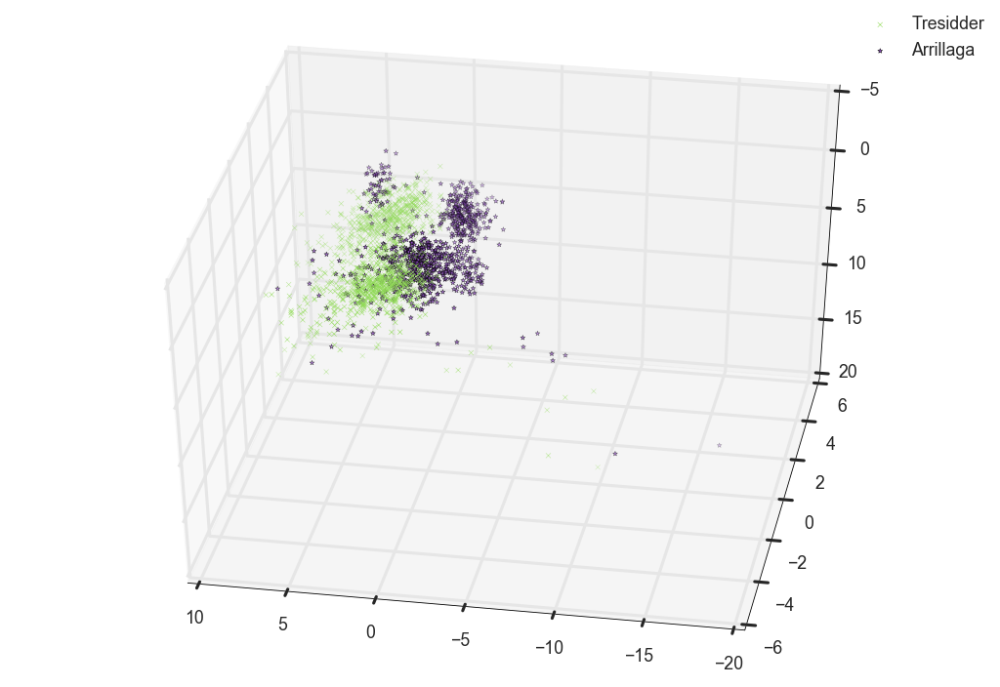

<IPython.core.display.Javascript object>


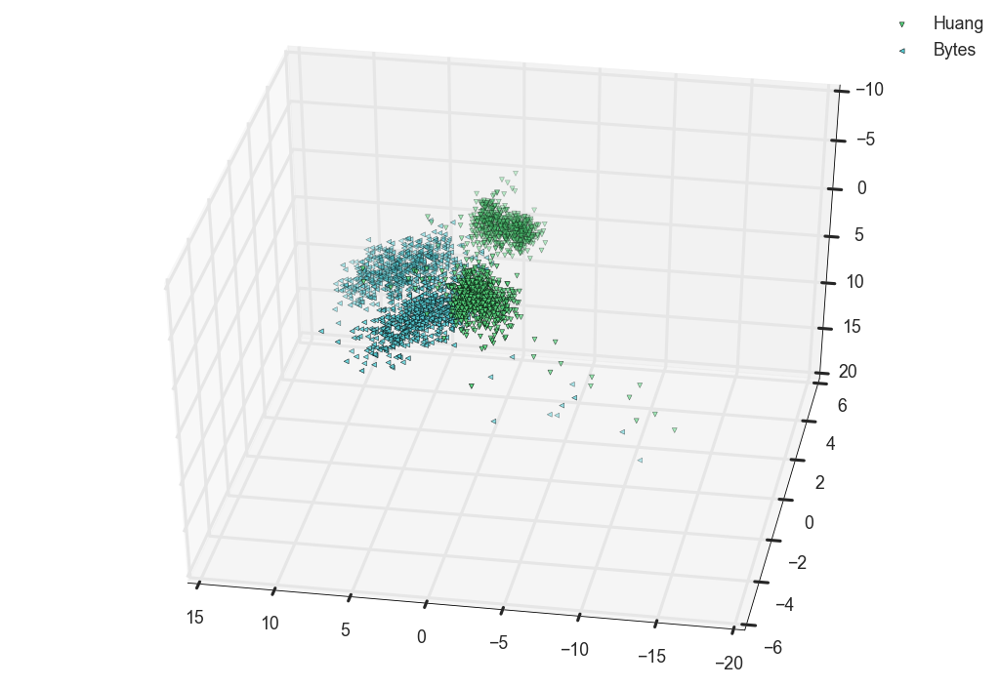

<IPython.core.display.Javascript object>


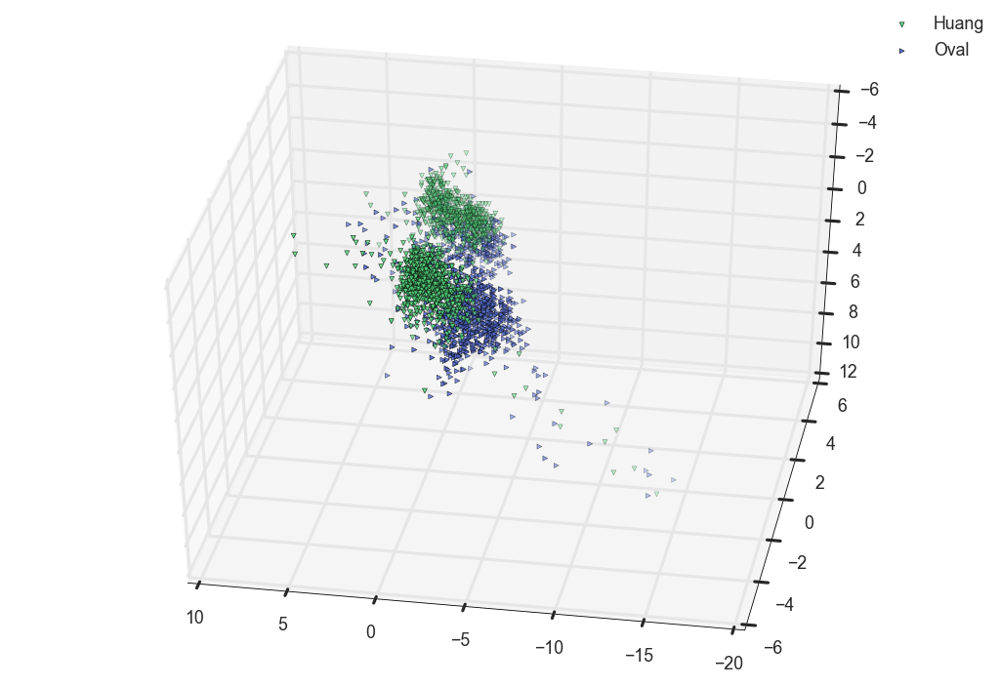

c:\Anaconda2\envs\CVX\lib\site-packages\matplotlib\pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


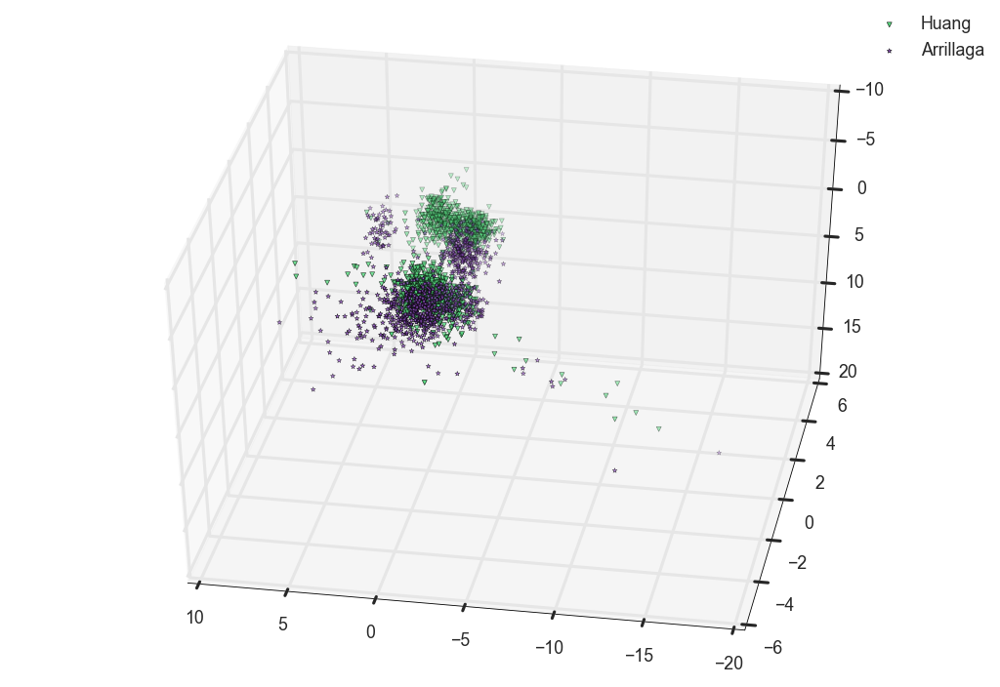

<IPython.core.display.Javascript object>


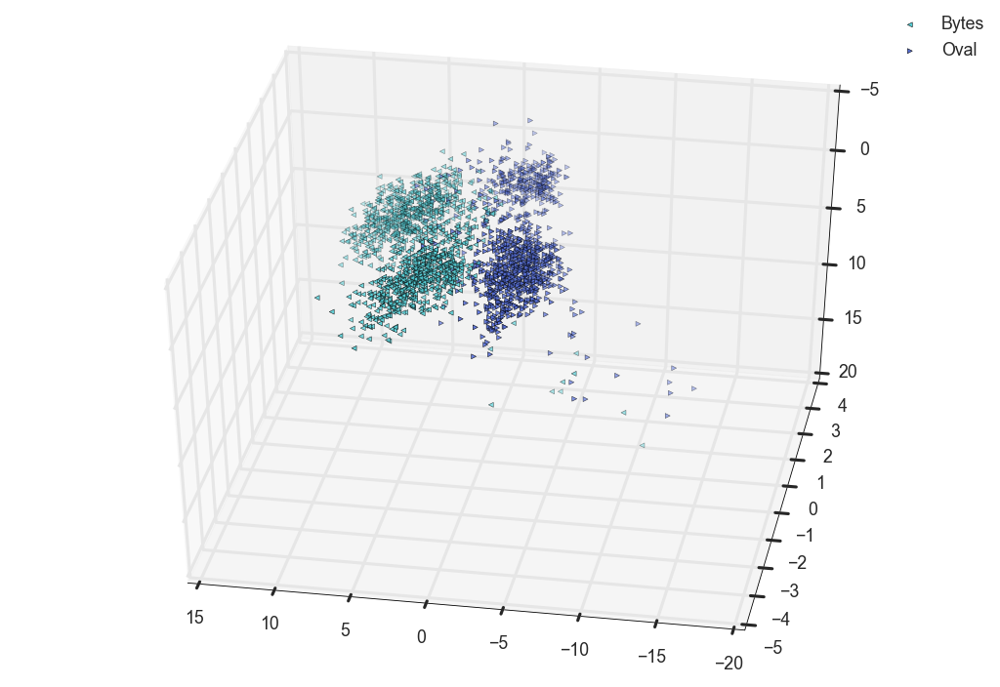

<IPython.core.display.Javascript object>


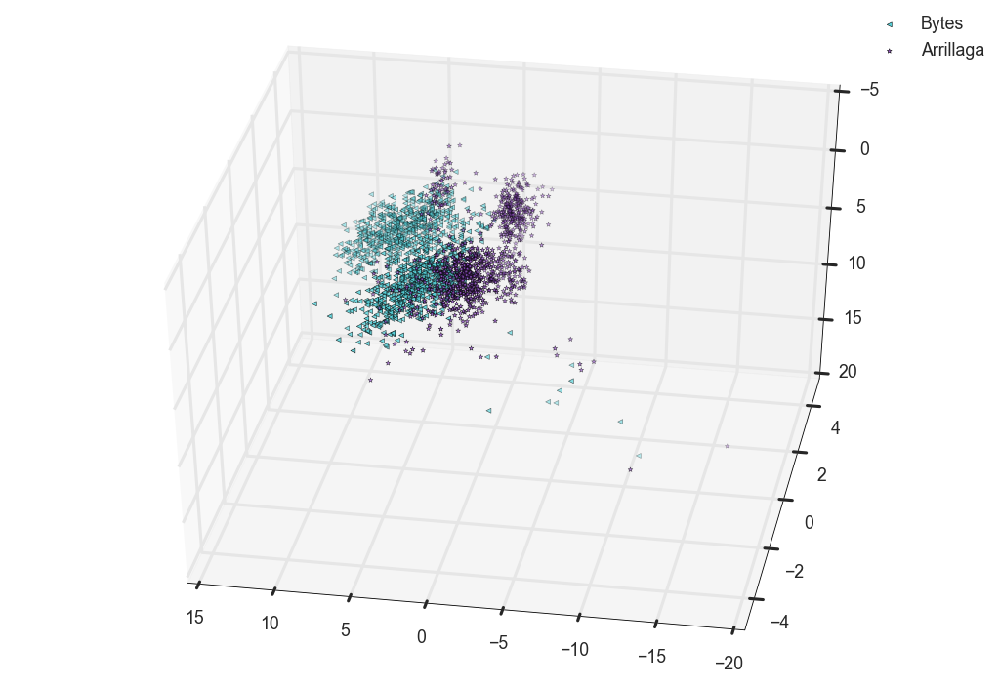

<IPython.core.display.Javascript object>


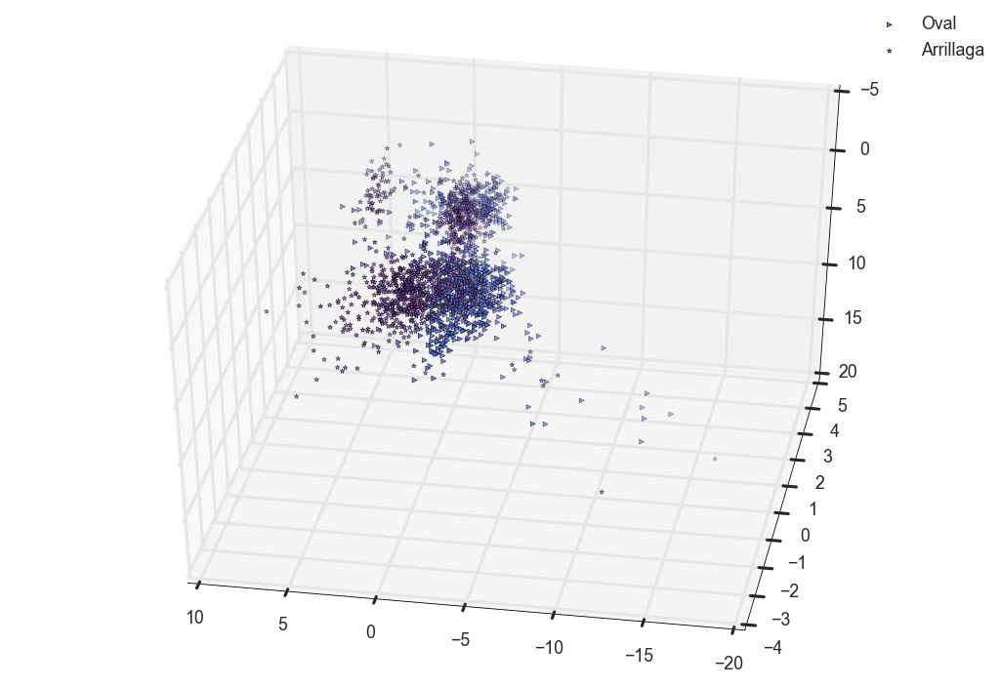

In [12]:
for i in range(7):
    for j in range(i,7):
        if i != j:
            ax = plotRegions(samples.REGIONS,pca_df_train,i,j)

c:\Anaconda2\envs\CVX\lib\site-packages\matplotlib\pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


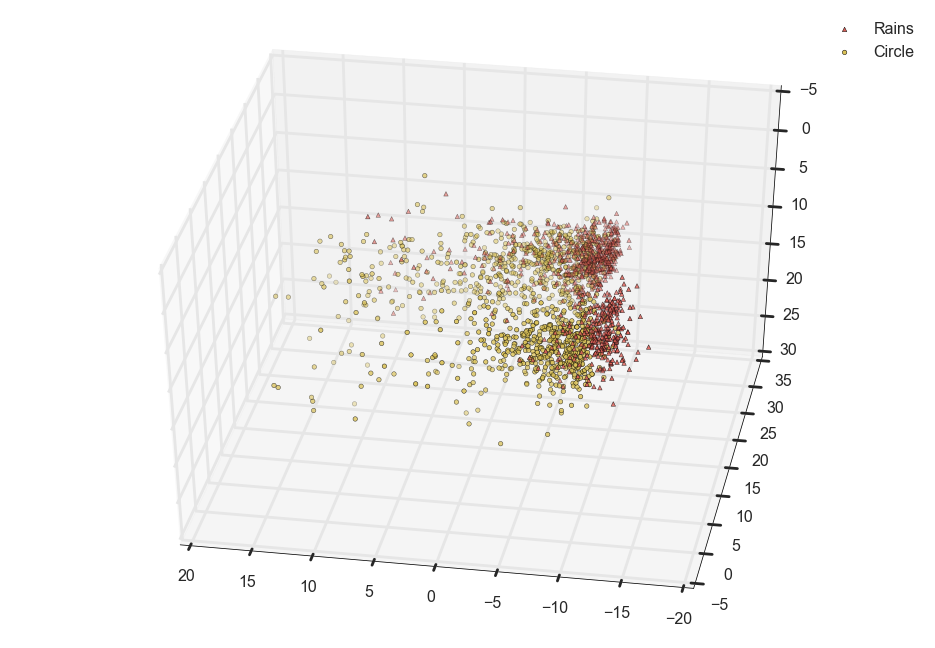

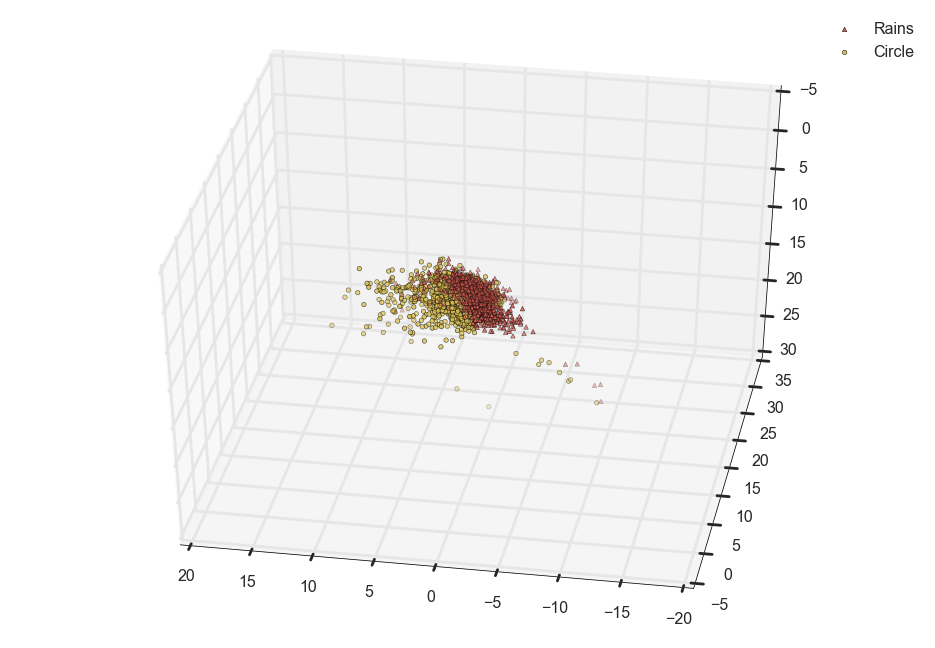

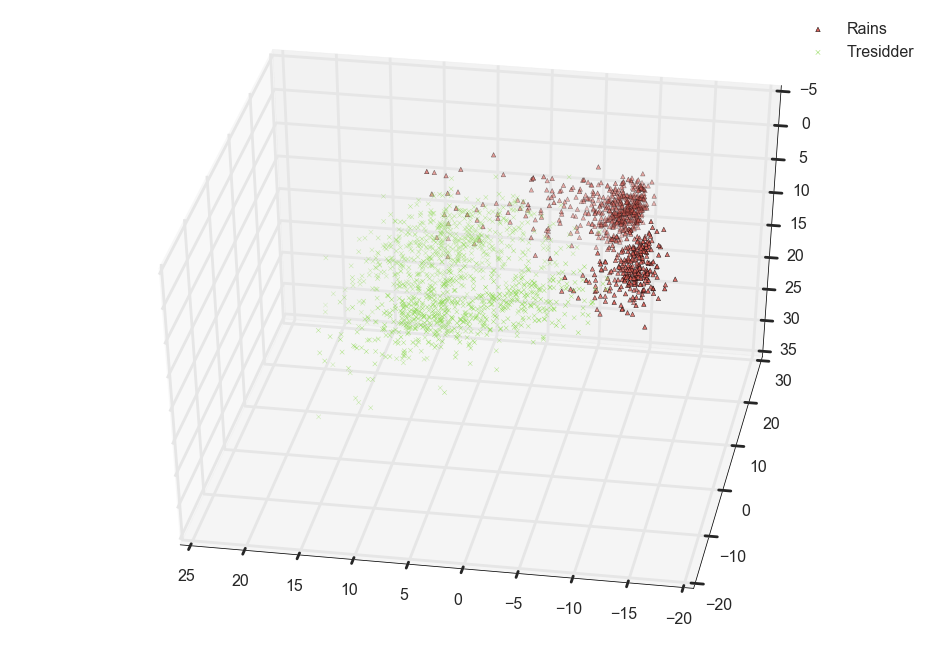

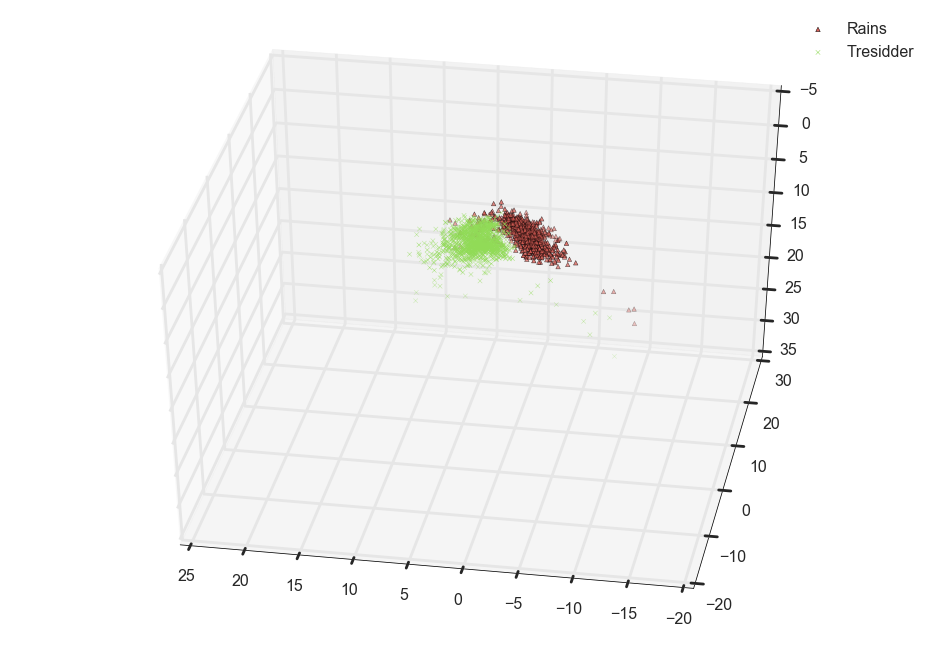

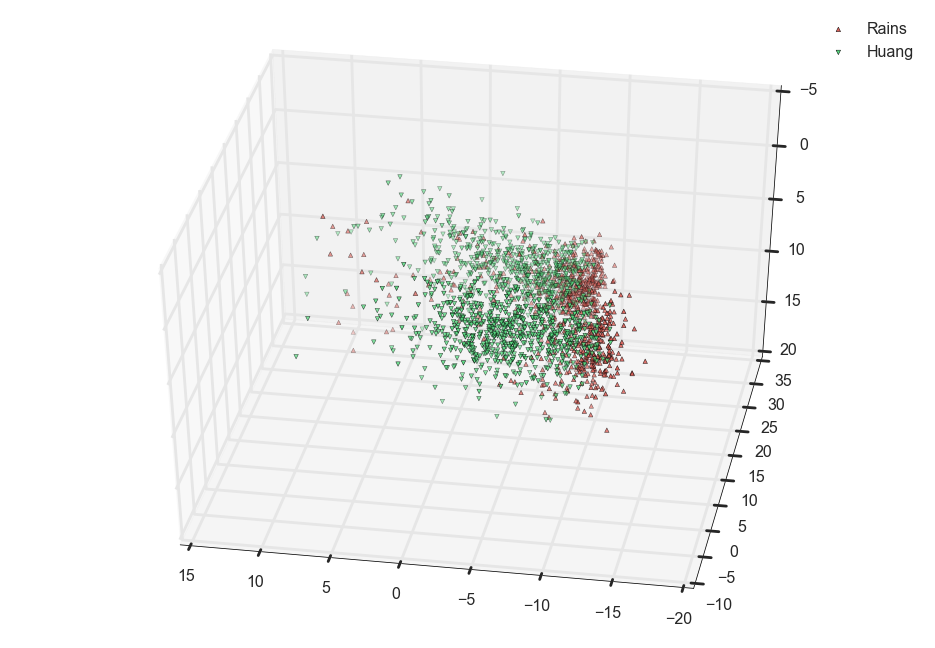

...

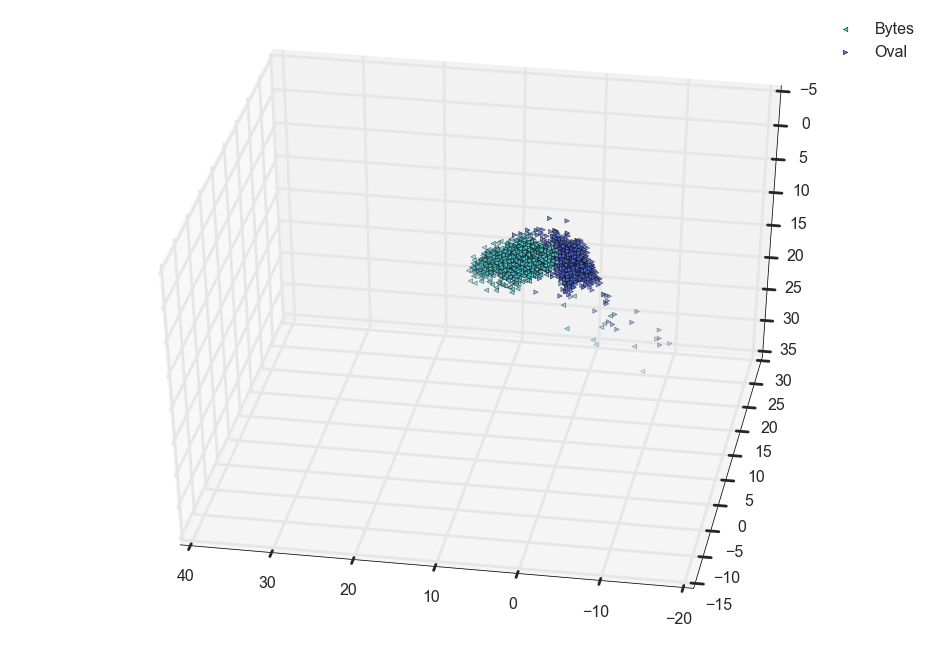

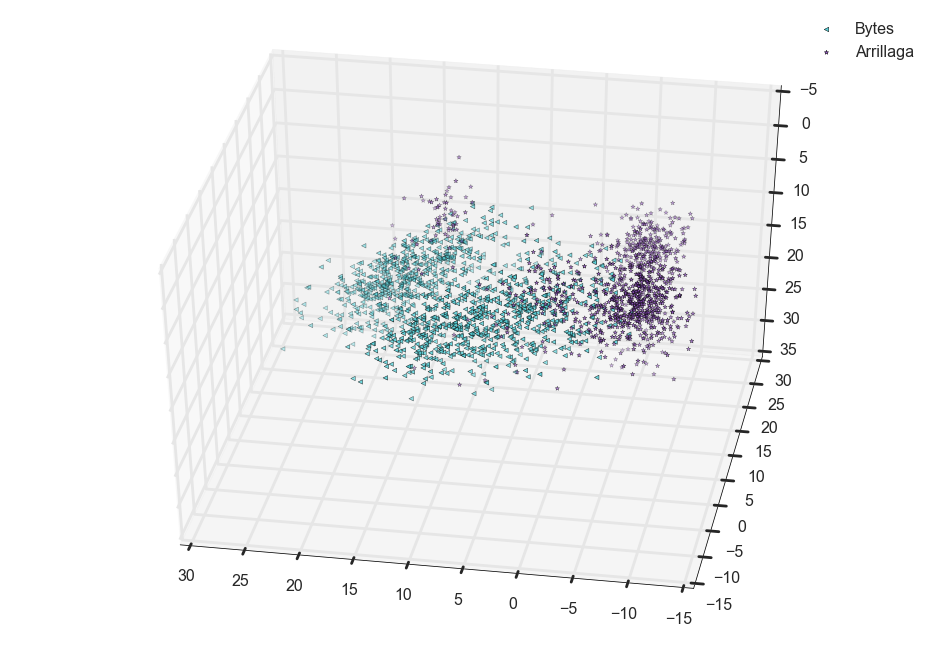

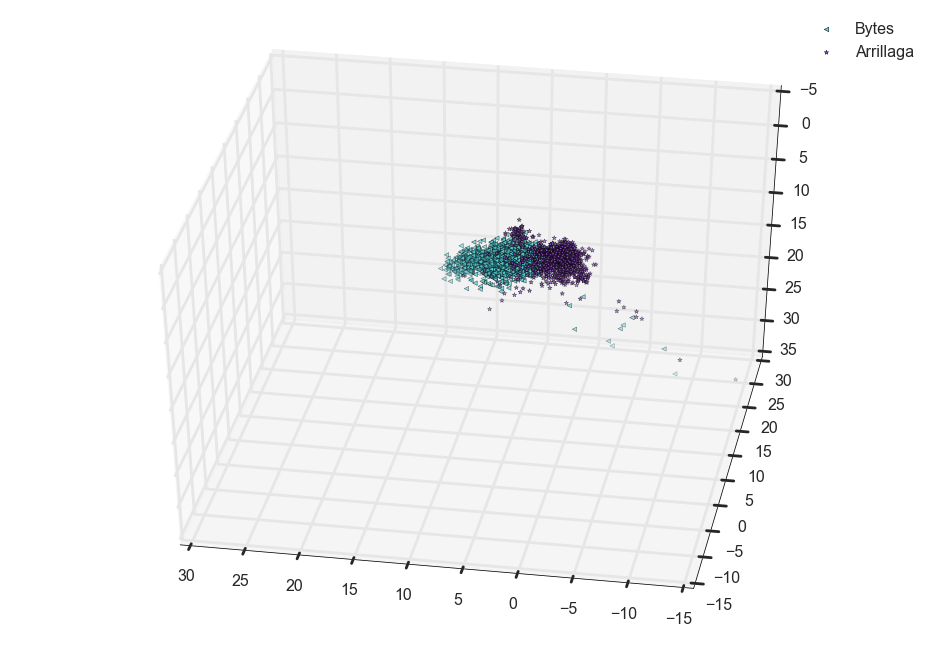

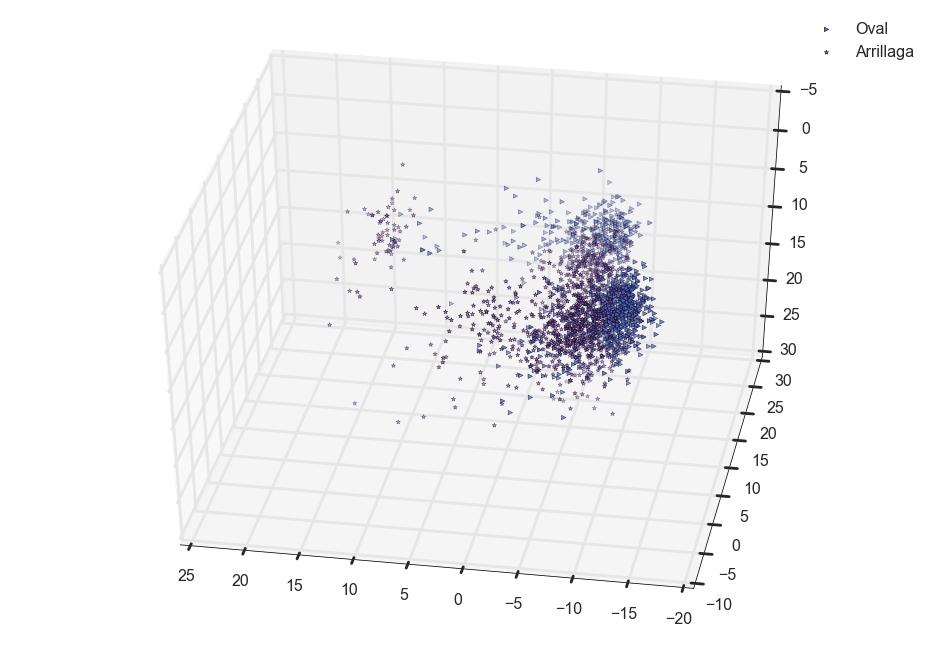

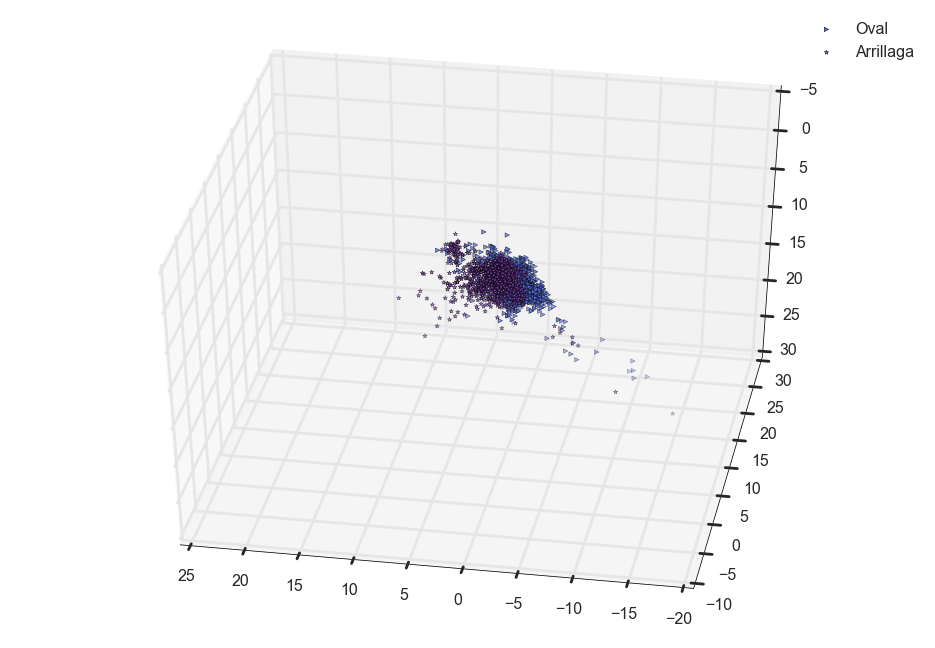

In [11]:
for i in range(7):
    for j in range(i,7):
        if i != j:
            ax = plotRegions(samples.REGIONS,pca_df_test,i,j)
            xlims = ax.get_xlim()
            ylims = ax.get_ylim()
            zlims = ax.get_zlim()
            ax = plotRegions(samples.REGIONS,pca_df_train,i,j)
            ax.set_xlim(xlims)
            ax.set_ylim(ylims)
            ax.set_zlim(zlims)

Number of Principal Components to explain 95.00% of variance: 50


PCA(copy=True, n_components=50, whiten=False)

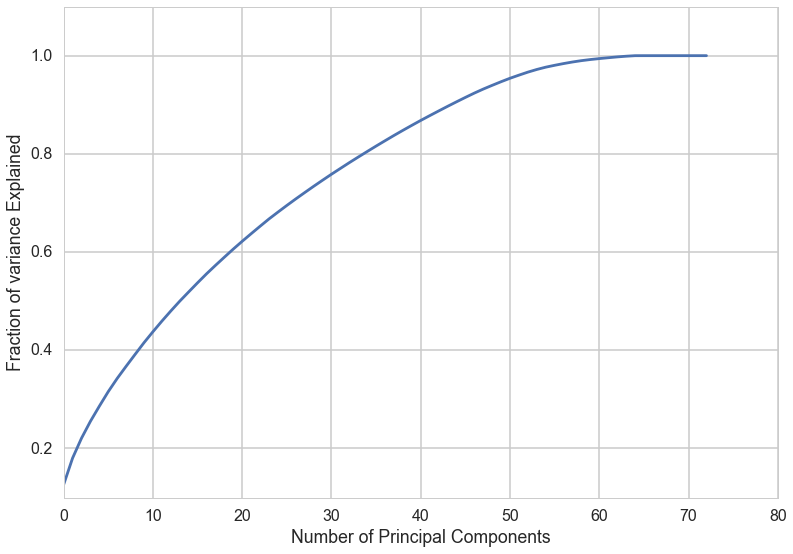

In [12]:
X_all = np.vstack((X_train,X_test))
Y_all = np.hstack((Y_train,Y_test))
pca_all = PCA(n_components=None,whiten=False)

X_all_pca = pca_all.fit_transform(preprocessing.scale(X_all))
var_thresh = 0.95
var_exp_all = pca_all.explained_variance_ratio_.cumsum()
plt.plot(var_exp)
num_pcs_all = np.where(var_exp_all>=var_thresh)[0][0]
plt.xlabel('Number of Principal Components')
plt.ylabel('Fraction of variance Explained')
print "Number of Principal Components to explain %.2f%% of variance: %d" %(var_thresh*100,num_pcs_all)
pca_all.set_params(n_components=num_pcs_all)

In [13]:
train_regions = pca_df_train.groupby('REGION')
test_regions = pca_df_test.groupby('REGION')

In [14]:
train_regions.describe()

pc1         pc10         pc11         pc12         pc13  \
REGION                                                                          
0      count   840.000000   840.000000   840.000000   840.000000   840.000000   
       mean     -2.097999    -0.228157     0.051620    -0.323809     0.143196   
       std       1.706177     1.060110     0.805083     0.800803     0.961353   
       min     -12.381354    -4.787010    -2.695934    -4.804181    -5.293579   
       25%      -2.974883    -0.695680    -0.448266    -0.822216    -0.196400   
       50%      -2.176259    -0.151035     0.027929    -0.302362     0.300651   
       75%      -1.153605     0.406615     0.508274     0.175901     0.740663   
       max       4.794106     4.088953     4.636739     3.068140     2.979559   
1      count  1200.000000  1200.000000  1200.000000  1200.000000  1200.000000   
       mean     -0.576812    -0.335304     0.032067     0.084521     0.213435   
       std       2.055239     1.221499     1.194123     1.442332     1.134319   
       min     -11.972823    -3.621610    -4.884512   -16.205851    -5.186857   
       25%      -1.818508    -1.093988    -0.692866    -0.410630    -0.372830   
       50%      -0.859380    -0.414434    -0.018483     0.164242     0.224000   
       75%       0.239566     0.276910     0.689848     0.727124     0.858128   
       max       9.023945     8.479492     7.084255     5.428228     5.483241   
2      count  1200.000000  1200.000000  1200.000000  1200.000000  1200.000000   
       mean      1.982145     0.216707     0.170301    -0.056678     0.022261   
       std       1.758012     1.220459     1.150268     1.124449     1.132629   
       min     -10.751087    -4.693124    -4.149037    -7.627985    -4.474734   
       25%       0.977126    -0.567442    -0.561276    -0.695706    -0.685227   
       50%       1.904982     0.216829     0.153582     0.014716     0.010278   
       75%       3.000832     0.970833     0.860262     0.649285     0.734949   
       max       7.659465     5.629569     5.352991     2.971945     4.199374   
3      count  1320.000000  1320.000000  1320.000000  1320.000000  1320.000000   
       mean     -0.940989     0.067343     0.002175     0.354430    -0.023141   
       std       1.379092     0.838686     0.911776     0.807578     0.797221   
       min     -13.829327    -3.682539    -2.241235    -2.523044    -4.360302   
       25%      -1.681688    -0.468056    -0.542478    -0.136116    -0.458442   
       50%      -0.866097     0.046834    -0.075826     0.343898    -0.004193   
       75%      -0.145351     0.542065     0.388996     0.783542     0.456612   
       max       6.247036     3.985951    10.663687     6.951984     3.835110   
4      count  1200.000000  1200.000000  1200.000000  1200.000000  1200.000000   
       mean      3.916733     0.151951    -0.037112     0.150750    -0.270886   
       std       2.510119     1.639774     1.487286     1.009412     1.562814   
       min     -11.495349    -4.506418    -5.826729    -3.518727    -5.037752   
       25%       2.222863    -0.943377    -0.963678    -0.481264    -1.269600   
       50%       3.757539     0.021163    -0.083823     0.130597    -0.270363   
       75%       5.640799     1.112806     0.806019     0.801489     0.734222   
       max       9.957233     7.085124     5.692431     3.091749     4.808646   
5      count  1020.000000  1020.000000  1020.000000  1020.000000  1020.000000   
       mean     -2.743301     0.160478     0.172403    -0.180740     0.245007   
       std       1.777796     1.064606     1.315865     1.154546     0.944033   
       min     -14.478698    -3.063975    -4.568440    -4.280018    -3.059481   
       25%      -3.733279    -0.486217    -0.633089    -0.846574    -0.287096   
       50%      -2.763231     0.133533    -0.019292    -0.274411     0.237310   
       75%      -1.887674     0.796160     0.816259     0.400125     0.834169   
       max       4.346396     4.393731     5.195540  

In [15]:
pca.set_params(n_components=num_pcs/2)

PCA(copy=True, n_components=25, whiten=False)

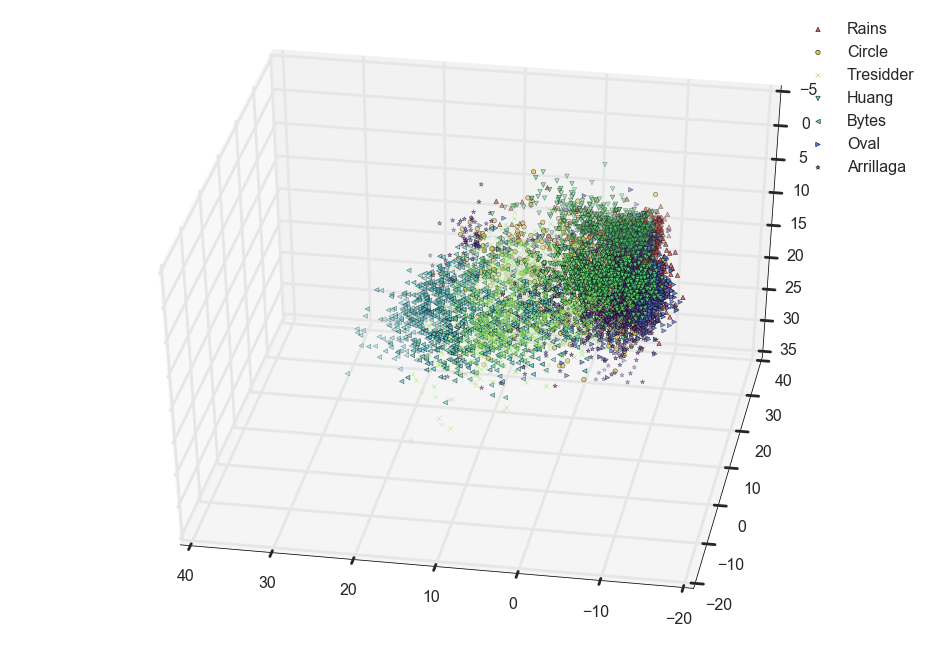

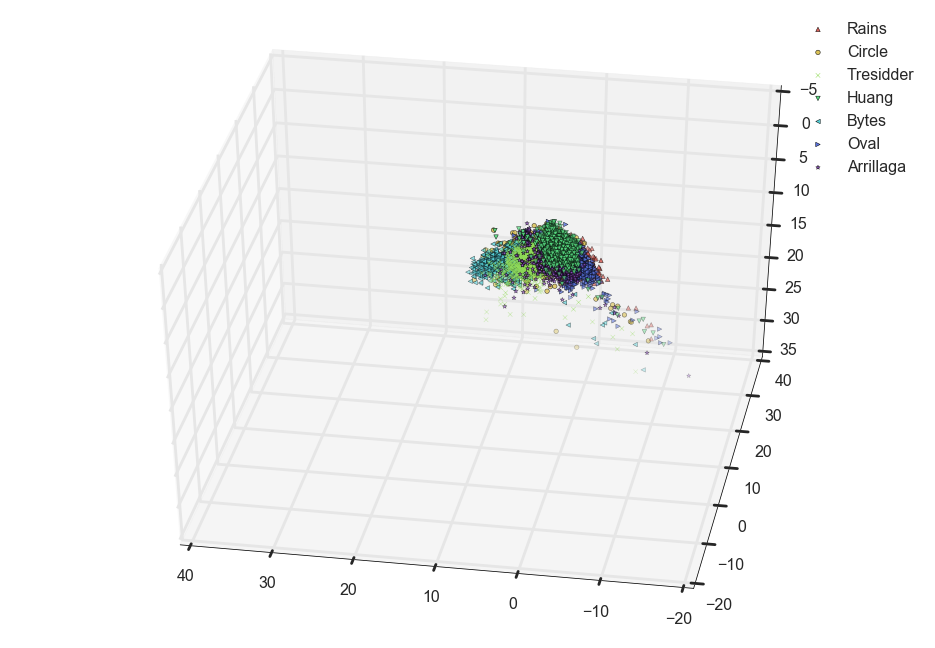

In [25]:
pca_df_test = pd.DataFrame()
test_pca = pca.transform(X_test)
for i in range(pca.n_components):
    pca_df_test["pc%i" % (i+1)] = test_pca[:,i]
pca_df_test['REGION'] = Y_test
ax = plotRegions(samples.REGIONS,pca_df_test,ax=None)
xlims = ax.get_xlim()
ylims = ax.get_ylim()
zlims = ax.get_zlim()

pca_df_train = pd.DataFrame()
for i in range(pca.n_components):
    pca_df_train["pc%i" % (i+1)] = X_pca[:,i]    
pca_df_train['REGION'] = Y_train
ax = plotRegions(samples.REGIONS,pca_df_train,ax=None)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_zlim(zlims)
plt.show()

In [ ]:
pca.n_components

(-5.0, 35.0)

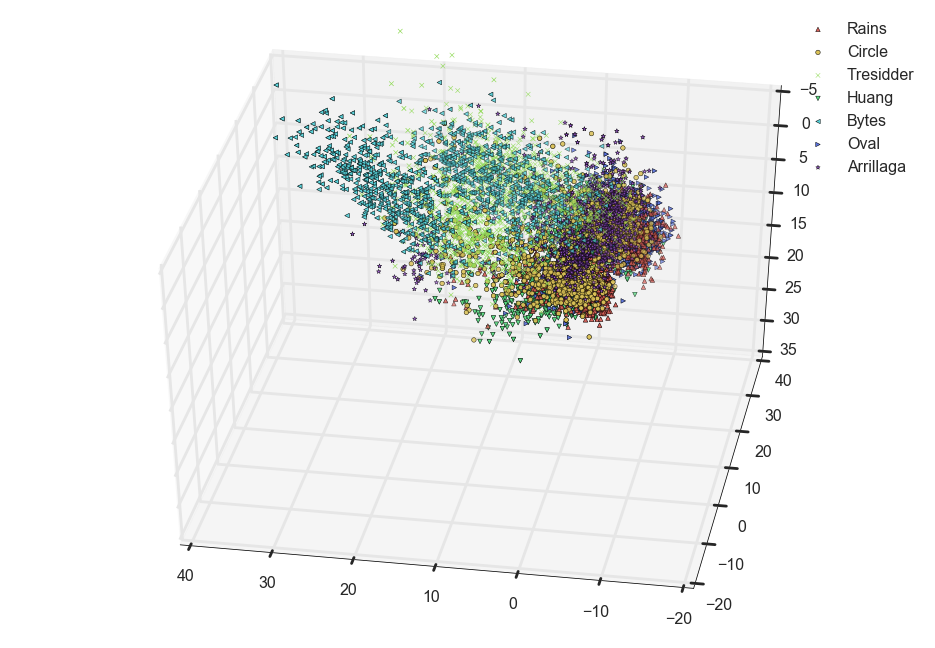

In [27]:
pca_df_all = pd.DataFrame()
all_pca = pca_all.transform(X_all)
for i in range(num_pcs):
    pca_df_all["pc%i" % (i+1)] = all_pca[:,i]
pca_df_all['REGION'] = Y_all
ax = plotRegions(samples.REGIONS,pca_df_all,ax=None)
ax.set_xlim(xlims)
ax.set_ylim(ylims)
ax.set_zlim(zlims)

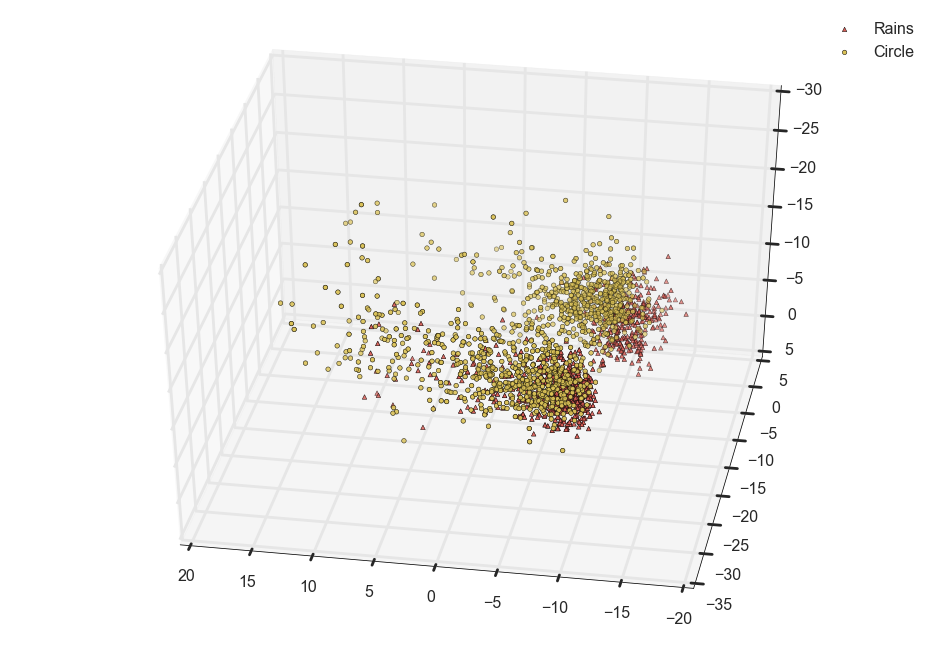

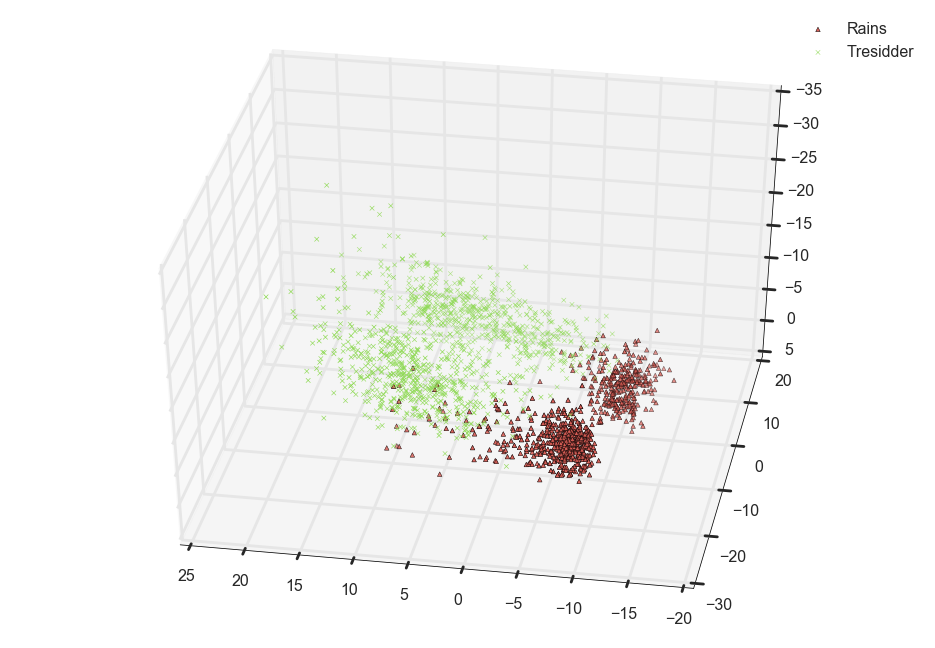

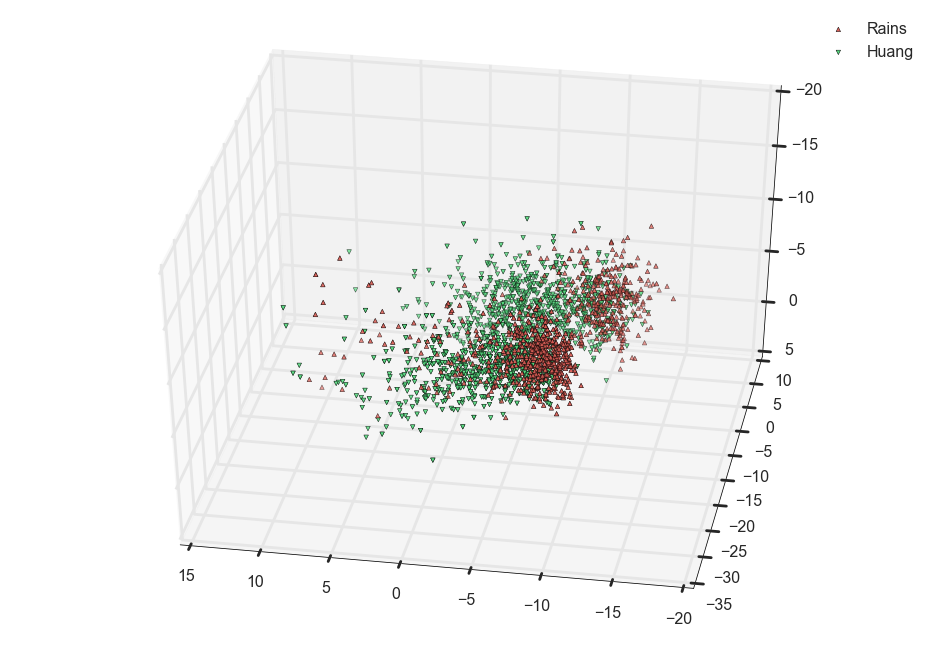

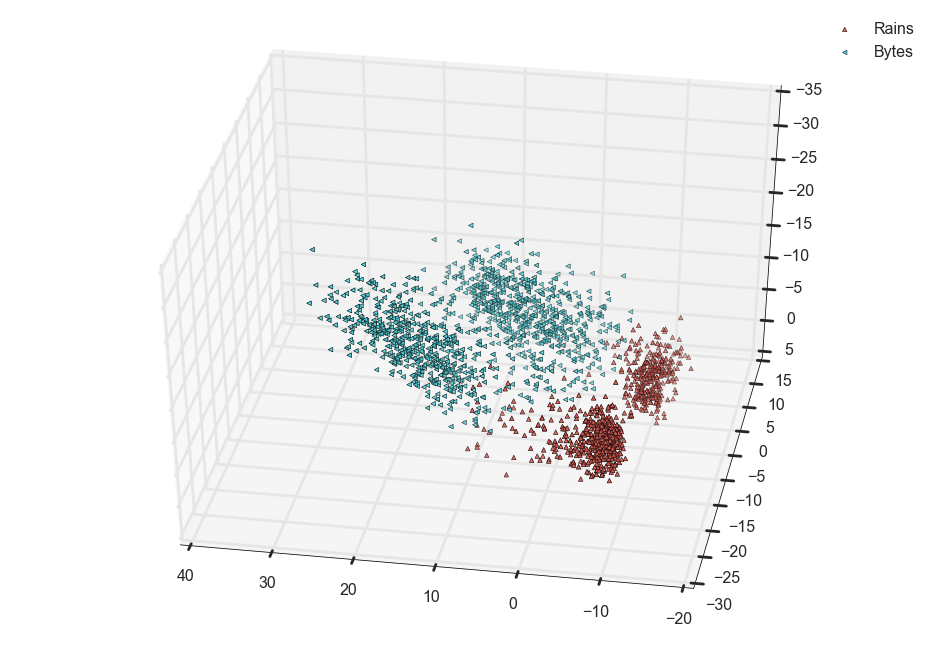

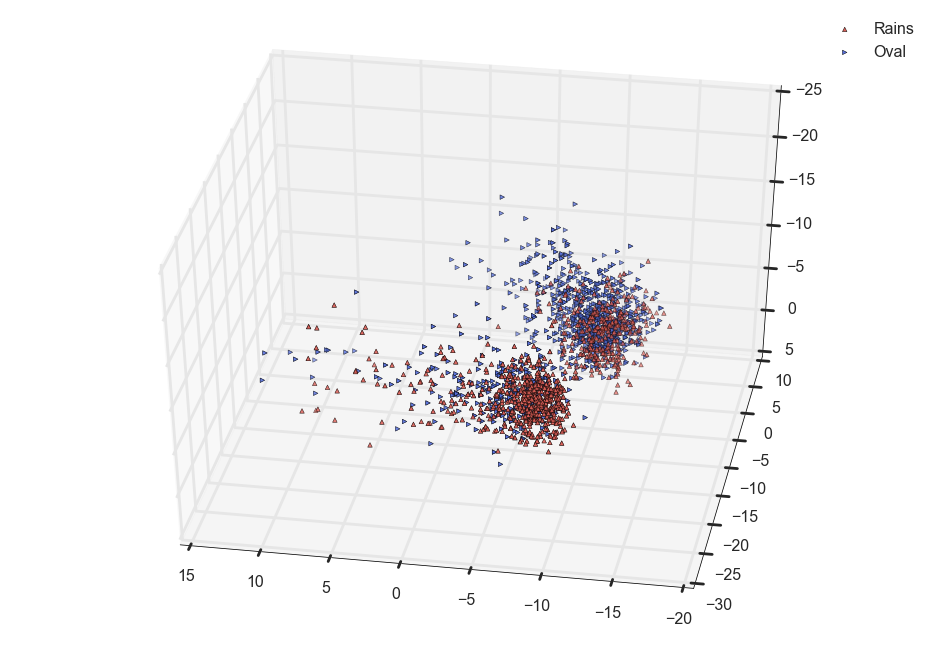

...

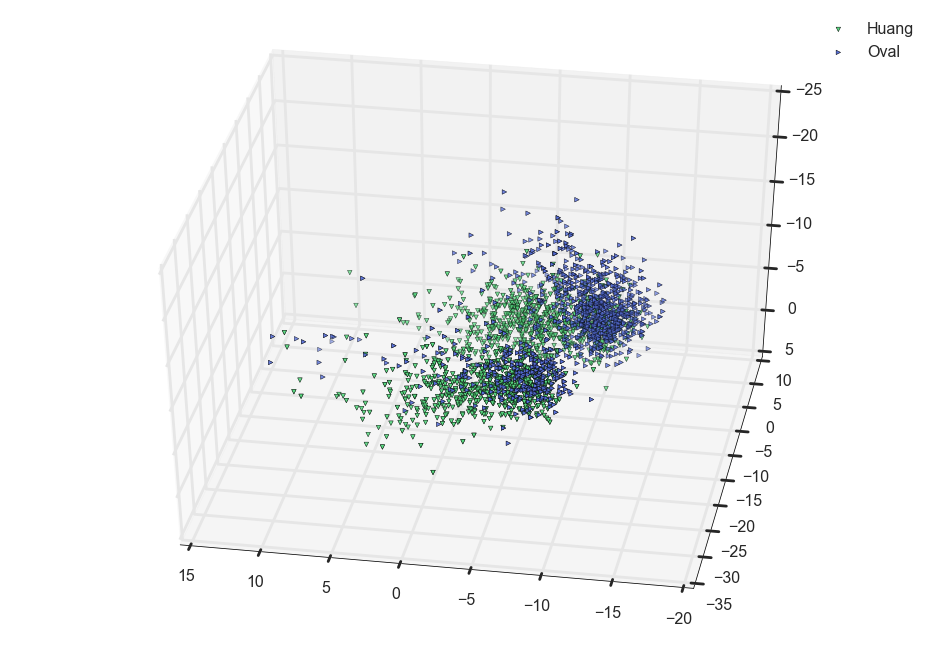

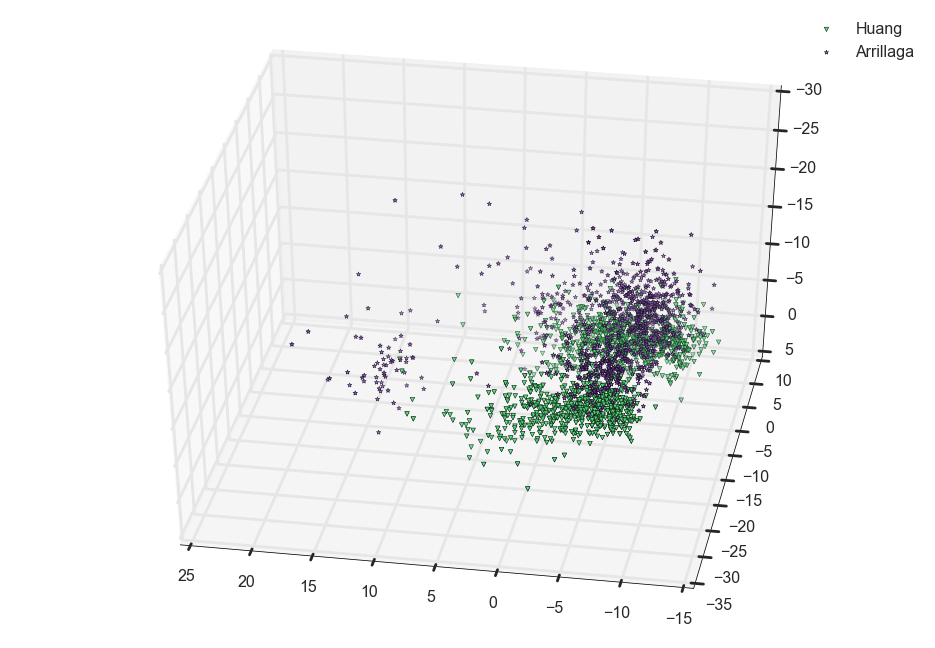

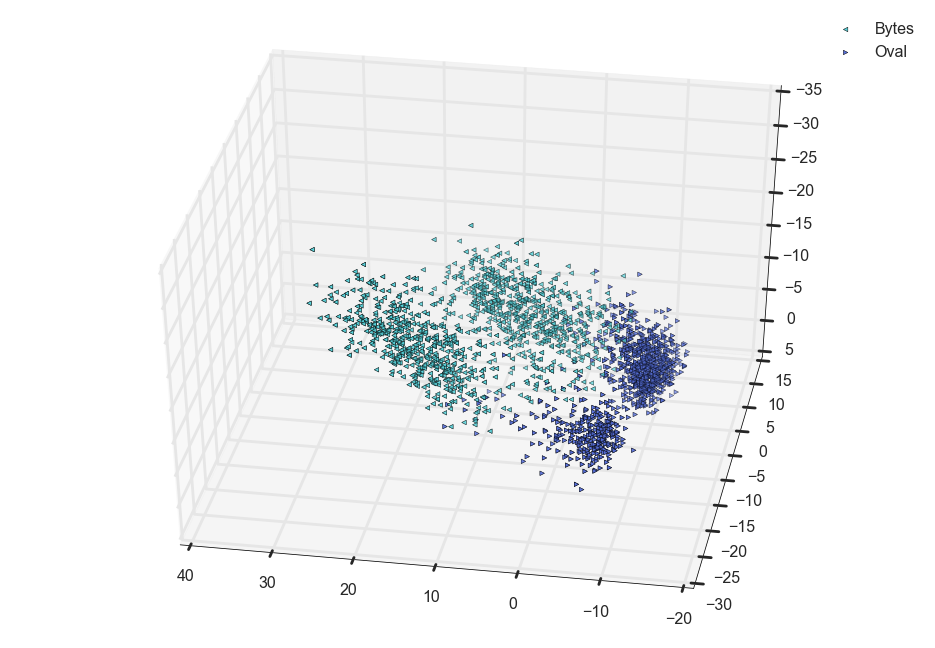

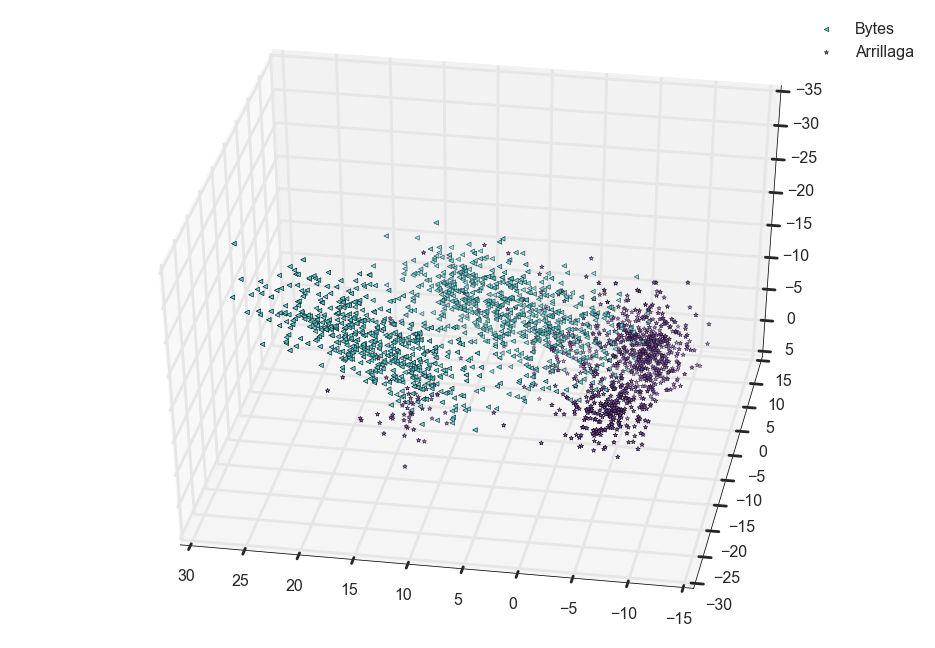

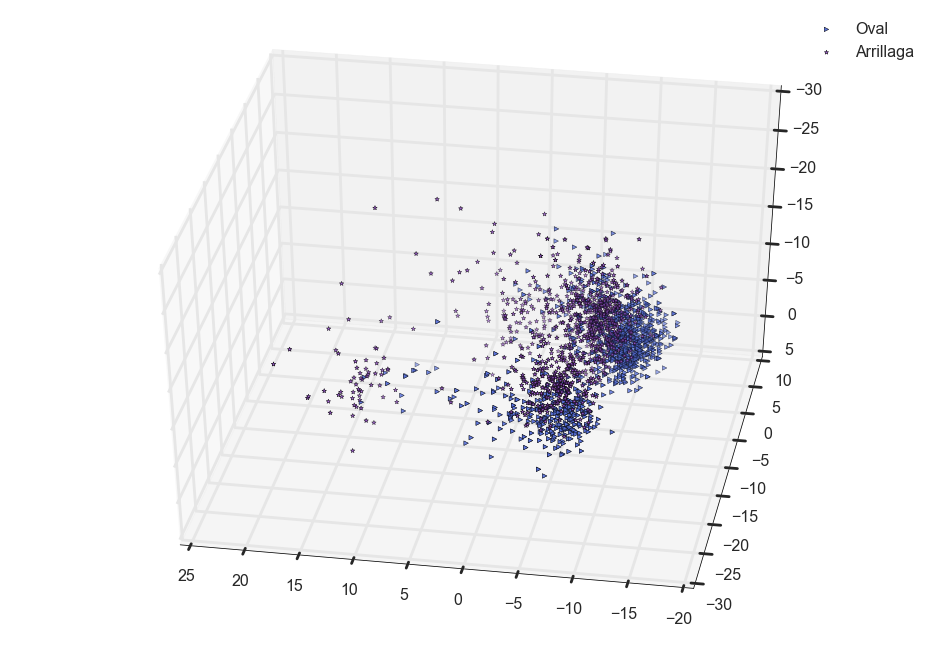

In [28]:
for i in range(7):
    for j in range(i,7):
        if i != j:
            ax = plotRegions(samples.REGIONS,pca_df_all,i,j)
            xlims = ax.get_xlim()
            ylims = ax.get_ylim()
            zlims = ax.get_zlim()

In [30]:
class pcaPhi:
    LEN = num_pcs;
    raw_phi = None
    pca_obj = None
    def __init__(self,raw_phi,pca_obj):
        self.raw_phi = raw_phi
        self.pca_obj = pca_obj
    def get_phi(self,sample):
        '''
        Takes in a super_sample and returns a feature array. Breaks the super_sample
        down into samples. Each row of the returned value corresponds to a sample
        in the super sample.
        '''
        raw = self.raw_phi.get_phi(sample)

        return self.pca_obj.transform(raw)
my_pca_phi = pcaPhi(myPhi,pca_all)

In [38]:
pca_X_sample = np.zeros((m,nsub,num_pcs))
pca_Y_sample = Y_train_compact
for i in range(m):
    for j in range(nsub):
        pca_X_sample[i,j,:] = X_pca[i*nsub+j,:num_pcs]
(pca_X_train,pca_Y_train,pca_X_test,pca_Y_test) = audiolearning.train_test_split_audio(pca_X_sample,pca_Y_sample)

In [40]:
svm_classifier = audiolearning.Classifier(my_pca_phi)
svm_classifier.trainSVMBatch(train_samples=None, X_train=pca_X_train,Y_train=pca_Y_train,C=0.6)

Finished Training Classifier with Training Error:---------------
Error for region 0: 0.0400
Error for region 1: 0.0549
Error for region 2: 0.0000
Error for region 3: 0.0000
Error for region 4: 0.0000
Error for region 5: 0.0833
Error for region 6: 0.0312
---- Total Training Error: 0.0279


0.027881040892193343

In [41]:
svm_classifier.testClassifier(test_samples=None,X_test=pca_X_test,Y_test=pca_Y_test)

-----------------------------------------------------
-------------------Testing Error:-------------------
Error for region 0: 0.1471
Error for region 1: 0.1724
Error for region 2: 0.0741
Error for region 3: 0.0750
Error for region 4: 0.0000
Error for region 5: 0.1333
Error for region 6: 0.0769
---- Total Testing Error: 0.0913


0.09130434782608698

In [43]:

pca_test 
pca_X_sample = np.zeros(X_test.shape)
pca_Y_sample = Y_test_compact
for i in range(m):
    for j in range(nsub):
        pca_X_sample[i,j,:] = test_PCA[i*nsub+j,:num_pcs]

(230L, 10L, 50L)

<IPython.core.display.Javascript object>


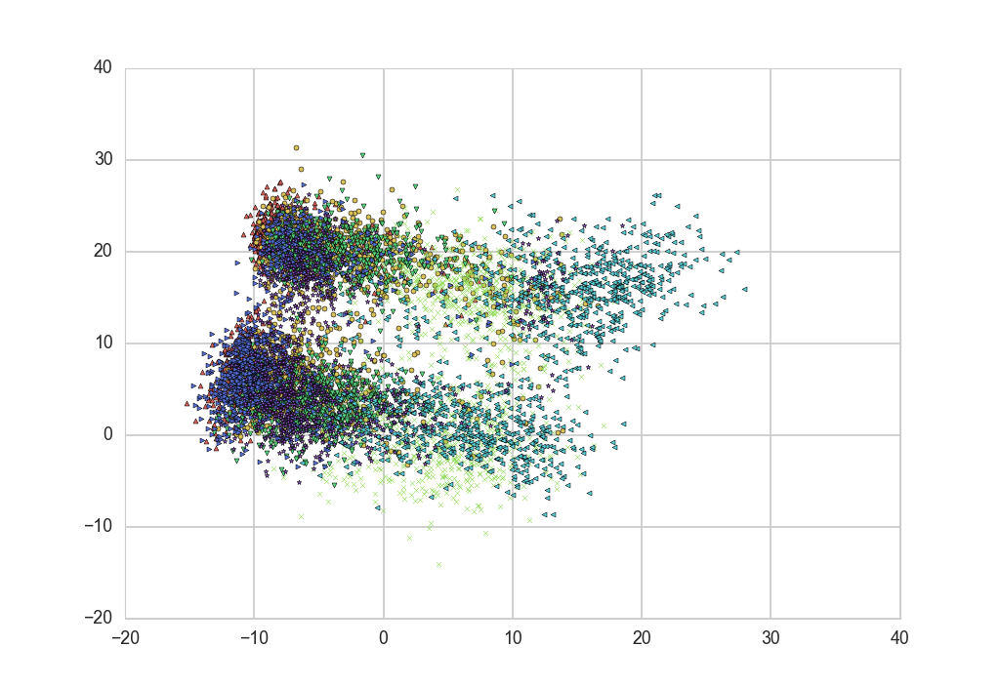

In [48]:
fig = plt.figure()
ax = fig.add_subplot(111)
num = len(samples.REGIONS)
colors = sns.color_palette("hls", 8)
markers = ['^','o','x','v','<','>','*']
for region_name,color,marker in zip(samples.REGIONS,colors,markers):
    region = samples.Regions_dict[region_name]
    mask = pca_df_test['REGION']==region
    ax.scatter(pca_df_test[mask]['pc1'],pca_df_test[mask]['pc2'],c=color,label=region_name,marker=marker)
plt.show()

In [35]:
plt.scatter((pca_df_test[mask]['pc1']).as_matrix(),(pca_df_test[mask]['pc2']).as_matrix())

ValueError: Cannot convert argument type <type 'numpy.ndarray'> to rgba array

In [33]:
(pca_df_test[mask]['pc1']).as_matrix().shape

(900L,)

In [37]:
x = (pca_df_test[mask]['pc1']).as_matrix()

In [38]:
y = (pca_df_test[mask]['pc2']).as_matrix()

<IPython.core.display.Javascript object>


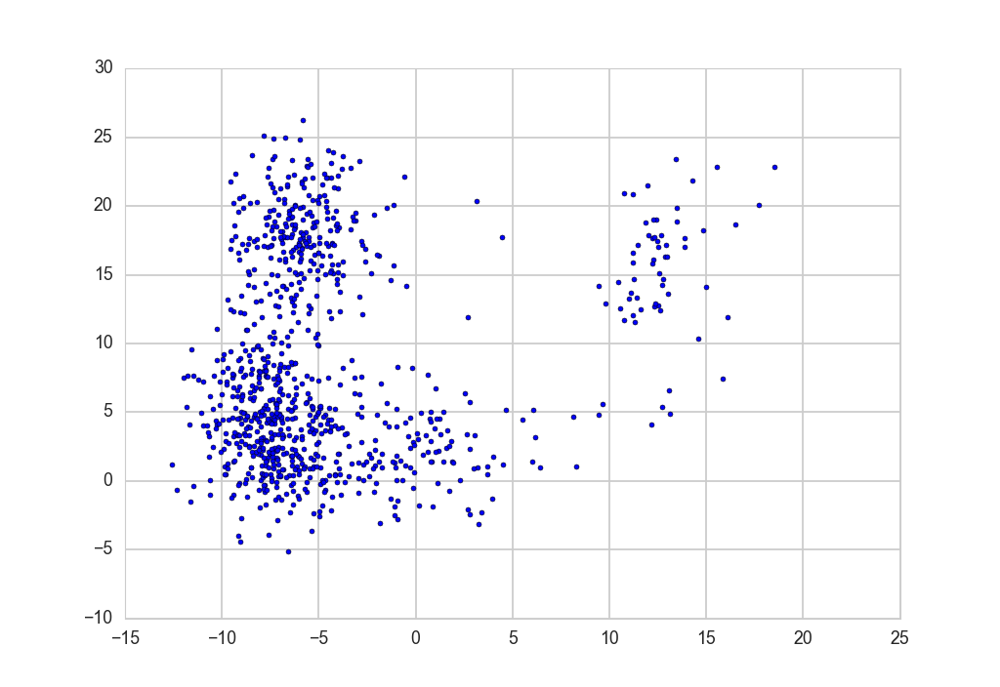

In [47]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.scatter(pca_df_test[mask]['pc1'],y)

In [44]:
x.shape

(900L,)

<IPython.core.display.Javascript object>


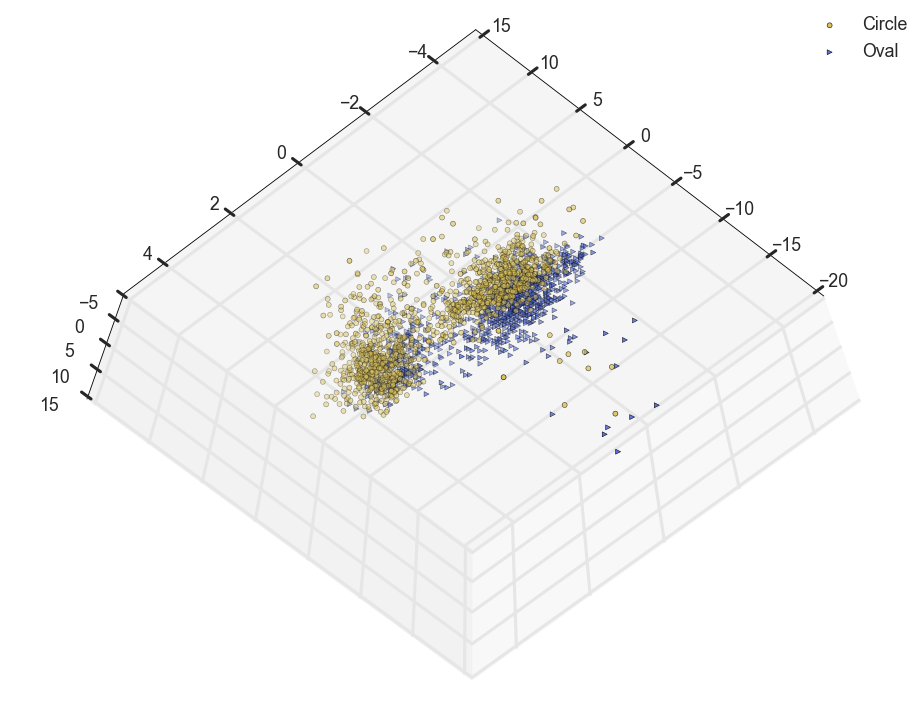

In [13]:
 ax = plotRegions(samples.REGIONS,pca_df_train,1,5)

In [14]:
region_df = pd.DataFrame(Y

NameError: name 'pca_df' is not defined

In [18]:
Y_train.shape

(7680L,)

In [19]:
Y_test.shape

(7680L,)

In [20]:
7680*2

15360

In [21]:
Y_train

array([6, 6, 6, ..., 2, 2, 2], dtype=int8)

In [22]:
Y_test

array([6, 6, 6, ..., 2, 2, 2], dtype=int8)